# Task 0
Functions

In [4]:
## Parity Plot

import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

plt.style.use('seaborn-v0_8-whitegrid')
plt.rcParams['font.family'] = 'Arial'
plt.rcParams['font.size'] = 12

def create_parity_plot(preds_path, test_path, column='ddGsolv'):
    """
    Create a publication-quality parity plot
    
    Parameters:
    preds_path (str): Path to predictions CSV file
    test_path (str): Path to test data CSV file
    column (str): Column name to plot
    """
    
    # Load the data
    df_pred = pd.read_csv(preds_path)
    df_data = pd.read_csv(test_path)
    
    # Extract the true and predicted values
    true_values = df_data[column]
    predicted_values = df_pred[column]
    
    # Calculate performance metrics
    mae = mean_absolute_error(true_values, predicted_values)
    rmse = mean_squared_error(true_values, predicted_values, squared=False)
    r2 = r2_score(true_values, predicted_values)
    
    # Create figure with better styling
    fig, ax = plt.subplots(figsize=(8, 8))  # Square plot
    
    # Set background and grid
    ax.set_facecolor('white')
    ax.grid(True, linestyle='-', alpha=0.3, color='gray', linewidth=0.5)
    ax.set_axisbelow(True)  # Put grid behind data points
    
    # Create the scatter plot with improved styling
    scatter = ax.scatter(
        true_values, 
        predicted_values, 
        alpha=0.7,
        c='#2E86C1',        # Professional blue color
        s=40,               # Slightly larger points for visibility
        edgecolors='white', # White edge for better contrast
        linewidth=0.5,
        label='Predictions',
        zorder=3            # Ensure points are above grid
    )
    
    # Add the parity line (y=x) with improved styling
    overall_min = min(min(true_values), min(predicted_values))
    overall_max = max(max(true_values), max(predicted_values))
    
    # Add some padding to the limits
    padding = (overall_max - overall_min) * 0.05
    plot_min = overall_min - padding
    plot_max = overall_max + padding
    
    ax.plot([plot_min, plot_max], [plot_min, plot_max], 
            'k--', linewidth=2, alpha=0.8, label='Perfect Prediction (y=x)', zorder=2)
    
    # Set plot labels and title with improved formatting
    ax.set_xlabel(f'Experimental {column} (kcal/mol)', fontsize=14, fontweight='bold')
    ax.set_ylabel(f'Predicted {column} (kcal/mol)', fontsize=14, fontweight='bold')
    ax.set_title(f'Parity Plot: Experimental vs Predicted {column}', 
                fontsize=16, fontweight='bold', pad=20)
    
    # Set the axis limits to make the plot square
    ax.set_xlim(plot_min, plot_max)
    ax.set_ylim(plot_min, plot_max)
    ax.tick_params(axis='both', which='major', labelsize=12)
    
    # Improve the statistics box styling
    stats_text = (f'$R^2$ = {r2:.2f}\n'
                  f'MAE = {mae:.3f} kcal/mol\n'
                  f'RMSE = {rmse:.3f} kcal/mol')
    
    props = dict(boxstyle='round,pad=0.5', facecolor='white', 
                edgecolor='black', alpha=0.95, linewidth=1)
    ax.text(0.05, 0.95, stats_text, transform=ax.transAxes, fontsize=11,
            verticalalignment='top', bbox=props, zorder=4)
    
    # Improve legend styling and position
    legend = ax.legend(loc='lower right', fontsize=11, frameon=True, 
                      fancybox=True, shadow=True, framealpha=0.95)
    legend.get_frame().set_facecolor('white')
    legend.get_frame().set_edgecolor('black')
    
    # Style the plot spines
    for spine in ax.spines.values():
        spine.set_edgecolor('black')
        spine.set_linewidth(1.2)
    
    # Ensure equal aspect ratio for square plot
    ax.set_aspect('equal', adjustable='box')
    
    # Adjust layout and display
    fig.tight_layout()
    plt.show()
    
    # Print metrics to console
    print(f"\nModel Performance Metrics for {column}:")
    print(f"R² Score: {r2:.3f}")
    print(f"MAE: {mae:.3f} kcal/mol")
    print(f"RMSE: {rmse:.3f} kcal/mol")
    print(f"Number of samples: {len(true_values)}")
    
    return fig, ax


# Task 1
Reproduce Chung's Model

In [1]:
import os
import sys

sys.path.append("Users/yahya/Desktop/Code/chemprop/chemprop")

import chemprop
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

## Task 1.1


Check diversity of Dataset

In [2]:
path = 'Data/Pretraining/pretraining_rxn_solvent_ddGsolv_ddHsolv_500k.csv'
df = pd.read_csv(path)
print(f"Dataset shape: {df.shape}")
display(df.head())

Dataset shape: (500000, 4)


,rxn_smiles,solvent_smiles,ddGsolv,ddHsolv
0,[N:1]([c:2]1[c:3]([H:9])[c:4]([H:10])[c:5]([H:...,S=C=S,-1.57,-2.13
1,[C:1]([C:2]([O:5]/[C:4](=[N:3]/[H:12])[C:6]([H...,CCOCCO,-0.27,-0.18
2,[N:1]#[C:2][C@@:3]1([H:8])[O:4][C@@:5]2([H:9])...,OCCOCCCC,-3.84,-5.62
3,[O:1]=[C:2]([C@@:6]([C:5]([C:4](=[C:3]([H:10])...,OCCCCCO,-3.66,-4.09
4,[C:1](=[C:2]([c:3]1[c:4]([H:10])[c:5]([H:11])[...,C(CC1)CCC1C2CCCCC2,0.13,0.29


In [3]:
unique_reactions = df['rxn_smiles'].unique()
total_unique_reactions = len(unique_reactions)
print(f"Found {total_unique_reactions} unique reaction SMILES strings in the dataset.")

Found 26448 unique reaction SMILES strings in the dataset.


c:\Users\Omary\miniconda3\envs\chemprop_official\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
Generating Bond Signatures:   0%|          | 0/26448 [00:00<?, ?it/s][20:31:44] WARNING: not removing hydrogen atom without neighbors
[20:31:45] WARNING: not removing hydrogen atom without neighbors
[20:31:45] WARNING: not removing hydrogen atom without neighbors
Generating Bond Signatures:   2%|▏         | 598/26448 [00:00<00:04, 5970.94it/s][20:31:45] WARNING: not removing hydrogen atom without neighbors
[20:31:45] WARNING: not removing hydrogen atom without neighbors
[20:31:45] WARNING: not removing hydrogen atom without neighbors
[20:31:45] WARNING: not removing hydrogen atom without neighbors
[20:31:45] WARNING: not removing hydrogen atom without neighbors
Generating Bond Signatures:   7%|▋         | 1898/26448 [0

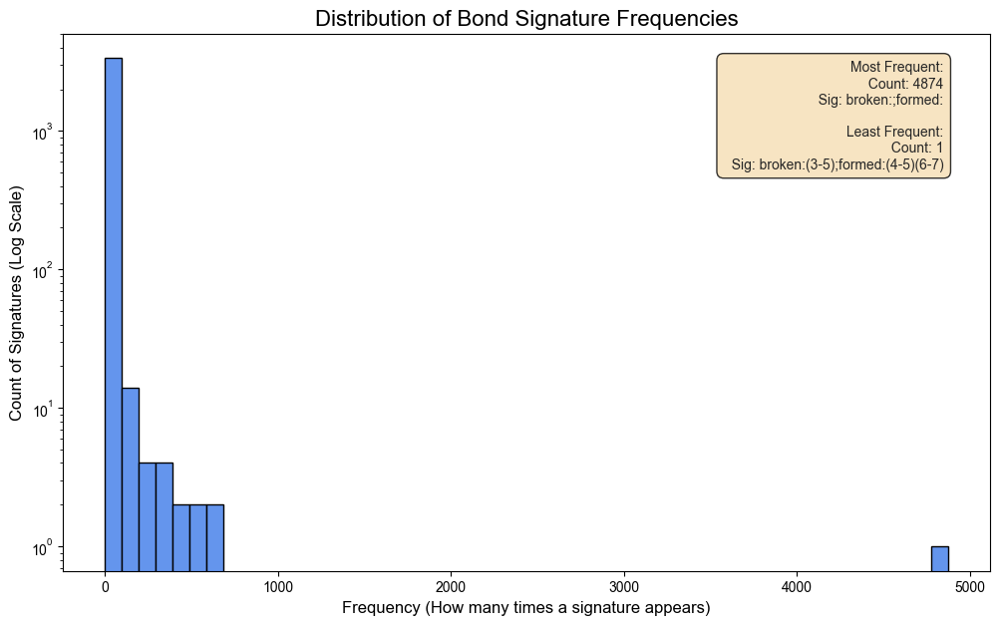

In [4]:
import pandas as pd
from rdkit import Chem
from tqdm.auto import tqdm
import matplotlib.pyplot as plt


def get_bond_signature(reaction_smiles):
    try:
        r_smiles, p_smiles = reaction_smiles.split('>>')
        mol_r = Chem.MolFromSmiles(r_smiles)
        mol_p = Chem.MolFromSmiles(p_smiles)
        if not mol_r or not mol_p: return None
        reactant_bonds = set(tuple(sorted((b.GetBeginAtom().GetAtomMapNum(), b.GetEndAtom().GetAtomMapNum()))) for b in mol_r.GetBonds() if b.GetBeginAtom().GetAtomMapNum() and b.GetEndAtom().GetAtomMapNum())
        product_bonds = set(tuple(sorted((b.GetBeginAtom().GetAtomMapNum(), b.GetEndAtom().GetAtomMapNum()))) for b in mol_p.GetBonds() if b.GetBeginAtom().GetAtomMapNum() and b.GetEndAtom().GetAtomMapNum())
        bonds_broken = sorted(list(reactant_bonds - product_bonds))
        bonds_formed = sorted(list(product_bonds - reactant_bonds))
        broken_str = "".join([f"({b[0]}-{b[1]})" for b in bonds_broken])
        formed_str = "".join([f"({b[0]}-{b[1]})" for b in bonds_formed])
        return f"broken:{broken_str};formed:{formed_str}"
    except Exception:
        return None

# Run the function on all unique reactions
tqdm.pandas(desc="Generating Bond Signatures")
signatures = pd.Series(unique_reactions).progress_apply(get_bond_signature).dropna()

# Analyze the frequencies
signature_counts = signatures.value_counts()

# --- NEW CODE: Prepare text for the legend box ---
# Get the most frequent signature and its count
most_common_sig = signature_counts.index[0]
most_common_count = signature_counts.iloc[0]

# Get the least frequent signature and its count
# Note: Many signatures will have a count of 1. This just picks one of them.
least_common_sig = signature_counts.index[-1]
least_common_count = signature_counts.iloc[-1]

# Truncate long signatures so the box isn't too wide
if len(most_common_sig) > 40:
    most_common_sig = most_common_sig[:40] + '...'
if len(least_common_sig) > 40:
    least_common_sig = least_common_sig[:40] + '...'
    
# Format the text string for the box
legend_text = (
    f"Most Frequent:\n"
    f"  Count: {most_common_count}\n"
    f"  Sig: {most_common_sig}\n\n"
    f"Least Frequent:\n"
    f"  Count: {least_common_count}\n"
    f"  Sig: {least_common_sig}"
)
# ----------------------------------------------------

fig, ax = plt.subplots(figsize=(12, 7))
plt.style.use('seaborn-v0_8-whitegrid')
ax.hist(
    signature_counts.values, 
    bins=50, 
    color='cornflowerblue',
    edgecolor='black',
    log=True
)
props = dict(boxstyle='round,pad=0.5', facecolor='wheat', alpha=0.8)
ax.text(0.95, 0.95, legend_text, transform=ax.transAxes, fontsize=10,
        verticalalignment='top', horizontalalignment='right', bbox=props)
ax.set_title('Distribution of Bond Signature Frequencies', fontsize=16)
ax.set_xlabel('Frequency (How many times a signature appears)', fontsize=12)
ax.set_ylabel('Count of Signatures (Log Scale)', fontsize=12)

plt.show()

## Task 1.2

Sample the dataset for pre-training the model

In [5]:
import pandas as pd
import numpy as np

# --- Configuration ---
SOURCE_FILE = 'Data/Pretraining/pretraining_rxn_solvent_ddGsolv_ddHsolv_500k.csv' 
TARGET_SAMPLE_SIZE = 20000
NUM_REACTIONS_TO_KEEP = 5000  # Number of reactions is tunable -> For Now i selected 5000

df_500k = pd.read_csv(SOURCE_FILE)
all_unique_reactions = df_500k['rxn_smiles'].unique()
print(f"Dataset has {len(df_500k):,} rows.")
print(f"It contains {len(all_unique_reactions)} unique reactions.")

Dataset has 500,000 rows.
It contains 26448 unique reactions.


In [6]:
# Number of unique reactions to keep to represent the sampled dataset

num_to_sample = min(NUM_REACTIONS_TO_KEEP, len(all_unique_reactions))

np.random.seed(42) # Using a random seed and adjusting to 42 for reproducibility -> You can change it if needed
sampled_reaction_smiles = np.random.choice(
    all_unique_reactions, 
    size=num_to_sample, 
    replace=False
)

sampled_reactions_set = set(sampled_reaction_smiles)
df_pool = df_500k[df_500k['rxn_smiles'].isin(sampled_reactions_set)].copy() # Contains the number of datapoints that align with the data pool

In [7]:
# Guranteeing variety and filling to the targeted size specified

core_reactions = df_pool.drop_duplicates(subset=['rxn_smiles'])
core_solvents = df_pool.drop_duplicates(subset=['solvent_smiles'])

# Combine and remove duplicates to form the core set
df_core = pd.concat([core_reactions, core_solvents]).drop_duplicates().reset_index(drop=True)
print(f"Core sample size: {len(df_core):,} rows.")

# Find rows in our pool that are not in the core set
df_remaining_pool = df_pool[~df_pool.index.isin(df_core.index)]
n_needed = TARGET_SAMPLE_SIZE - len(df_core) # Calculate how many more samples we need

if n_needed > 0:
    # If we need more than we have left, just take all remaining points
    if n_needed >= len(df_remaining_pool):
        df_fill = df_remaining_pool
    else:
        df_fill = df_remaining_pool.sample(n=n_needed, random_state=42)
    
    # Combine the core set with the fill set
    df_final_sample = pd.concat([df_core, df_fill])

elif n_needed <= 0:
    print("Core sample is larger than the target size. Taking a random sample from the core set.")
    df_final_sample = df_core.sample(n=TARGET_SAMPLE_SIZE, random_state=42)

df_final_sample = df_final_sample.sample(frac=1, random_state=42).reset_index(drop=True) # Shuffle the final dataset

Core sample size: 5,014 rows.


In [8]:
# Save the new, representative 20k sample
SAVE_PATH = 'Data/Pretraining/pre-training_sampled_20k_representative.csv'
df_final_sample.to_csv(SAVE_PATH, index=False)

unique_reactions_in_sample = df_final_sample['rxn_smiles'].nunique()
unique_solvents_in_sample = df_final_sample['solvent_smiles'].nunique()

print(f" Number of Unique Reactions in Sample: {unique_reactions_in_sample}")
print(f" Number of unique solvents in Sample: {unique_solvents_in_sample}")

 Number of Unique Reactions in Sample: 5000
 Number of unique solvents in Sample: 295


## Task 1.3 
#### Pre-training the Model

In [5]:
import pandas as pd
import numpy as np
import os

# --- Configuration ---
SOURCE_DATA_PATH = 'Data/Pretraining/pre-training_sampled_20k_representative.csv' # The 20k file you just made
SPLIT_DIR = 'data_splits/C1' # A directory to hold the split files
SPLIT_SIZES = [0.72, 0.18, 0.1] # Train, Validation, Test proportions

# Create the directory if it doesn't exist
os.makedirs(SPLIT_DIR, exist_ok=True)

# Load the 20k dataset
df = pd.read_csv(SOURCE_DATA_PATH)

print(f"Starting with {len(df)} data points.")

# --- Perform the Reaction-Based Split ---
# 1. Get all unique reaction SMILES
unique_reactions = df['rxn_smiles'].unique()
np.random.shuffle(unique_reactions) # Shuffle for random splitting

# 2. Split the list of unique reactions into train, val, test sets
train_size = int(SPLIT_SIZES[0] * len(unique_reactions))
val_size = int(SPLIT_SIZES[1] * len(unique_reactions))

train_rxns = set(unique_reactions[:train_size])
val_rxns = set(unique_reactions[train_size : train_size + val_size])
test_rxns = set(unique_reactions[train_size + val_size:])

print(f"Splitting into {len(train_rxns)} train reactions, {len(val_rxns)} val reactions, {len(test_rxns)} test reactions.")

# 3. Create the dataframes based on these sets of reactions
df_train = df[df['rxn_smiles'].isin(train_rxns)]
df_val = df[df['rxn_smiles'].isin(val_rxns)]
df_test = df[df['rxn_smiles'].isin(test_rxns)]

# 4. Save the split files
train_path = os.path.join(SPLIT_DIR, 'train.csv')
val_path = os.path.join(SPLIT_DIR, 'val.csv')
test_path = os.path.join(SPLIT_DIR, 'test.csv')

df_train.to_csv(train_path, index=False)
df_val.to_csv(val_path, index=False)
df_test.to_csv(test_path, index=False)

print("\nData successfully split and saved:")
print(f"Train set: {len(df_train)} rows -> {train_path}")
print(f"Validation set: {len(df_val)} rows -> {val_path}")
print(f"Test set: {len(df_test)} rows -> {test_path}")

Starting with 20000 data points.
Splitting into 3600 train reactions, 900 val reactions, 500 test reactions.

Data successfully split and saved:
Train set: 14444 rows -> data_splits/C1\train.csv
Validation set: 3547 rows -> data_splits/C1\val.csv
Test set: 2009 rows -> data_splits/C1\test.csv


In [6]:
## This is referred to as C1_P-Model -> Chung's Pretrained Model
data_path = train_path
s_val_path = val_path

model_dir_C1 = 'Models/C1_P-Model'

TrainArgs_C1 = [
    '--data_path', data_path,
    '--separate_val_path',s_val_path,
    '--dataset_type', 'regression',
    '--save_dir', model_dir_C1,
    '--epochs', '80', # Specified by Paper to be 80
    '--ensemble_size', '5', # training multiple models for an ensembled - specified in Paper
    '--num_fold', '5',
    '--ffn_num_layers', '2',
    '--ffn_hidden_size', '600',
    '--hidden_size', '700',
    '--init_lr', '1e-5',                                # ADDED: Low learning rate
    '--max_lr', '1e-5',                                 # ADDED
    '--final_lr', '1e-8', 
    '--smiles_columns', 'rxn_smiles', 'solvent_smiles', # Specifies smiles columns - reaction and solvent
    '--reaction_solvent', # This is to ensure the model sees this as a reaction in presence of a solvent
    '--number_of_molecules', '2', # Number of Molecules
    '--target_columns', 'ddGsolv', 'ddHsolv', # Targetted Columns
    '--metric', 'rmse',
    '--extra_metrics', 'r2','mae',
    '--gpu', '0',
    '--num_workers', '0'  # Ensure to specify -> Larger values may cause data leakage
]


In [7]:
from chemprop.args import TrainArgs
from chemprop.train import cross_validate, run_training

P_TrainArgs_C1 = TrainArgs().parse_args(TrainArgs_C1)
results = cross_validate(args=P_TrainArgs_C1, train_func=run_training)

Command line
python c:\Users\Omary\miniconda3\envs\chemprop_official\lib\site-packages\ipykernel_launcher.py --f=c:\Users\Omary\AppData\Roaming\jupyter\runtime\kernel-v3729a67343be10604e717c660d3492f24b1c05c8a.json
Args
{'activation': 'ReLU',
 'adding_bond_types': True,
 'adding_h': False,
 'aggregation': 'mean',
 'aggregation_norm': 100,
 'atom_constraints': [],
 'atom_descriptor_scaling': True,
 'atom_descriptors': None,
 'atom_descriptors_path': None,
 'atom_descriptors_size': 0,
 'atom_features_size': 0,
 'atom_messages': False,
 'atom_targets': [],
 'batch_size': 50,
 'bias': False,
 'bias_solvent': False,
 'bond_constraints': [],
 'bond_descriptor_scaling': True,
 'bond_descriptors': None,
 'bond_descriptors_path': None,
 'bond_descriptors_size': 0,
 'bond_features_size': 0,
 'bond_targets': [],
 'cache_cutoff': 10000,
 'checkpoint_dir': None,
 'checkpoint_frzn': None,
 'checkpoint_path': None,
 'checkpoint_paths': None,
 'class_balance': False,
 'config_path': None,
 'constraint

### Task 1.3.1

##### Predicting - Refer to READme

In [1]:
s_test_path = 'data_splits/C1/test.csv'
preds_path = 'Data/Pred/Predicted_Data.csv'
model_dir_C1 = 'Models/C1_P-Model'


PredArgs_C1 = [
    '--test_path', s_test_path,
    '--preds_path', preds_path,
    '--checkpoint_dir', model_dir_C1,
    '--smiles_columns','rxn_smiles', 'solvent_smiles',
    '--number_of_molecules', '2',
    '--num_workers', '0',
]

In [30]:
import chemprop

P_PredArgs_C1 = chemprop.args.PredictArgs().parse_args(PredArgs_C1)
preds = chemprop.train.make_predictions(args=P_PredArgs_C1)

/Users/yahya/Desktop/Actual/Code/chemprop/chemprop/utils.py:489: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  vars(torch.load(path, map_location=lambda storage, loc: storag

Loading training args
Setting molecule featurization parameters to default.
Loading data


2009it [00:00, 457432.10it/s]
100%|██████████| 2009/2009 [00:00<00:00, 484078.63it/s]
[21:39:00] WARNING: not removing hydrogen atom without neighbors
[21:39:00] WARNING: not removing hydrogen atom without neighbors


Validating SMILES
Test size = 2,009


  0%|          | 0/25 [00:00<?, ?it/s]/Users/yahya/Desktop/Actual/Code/chemprop/chemprop/utils.py:120: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state = torch.load(path,

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".


  0%|          | 0/25 [00:00<?, ?it/s]


KeyError: 'atomic_num'

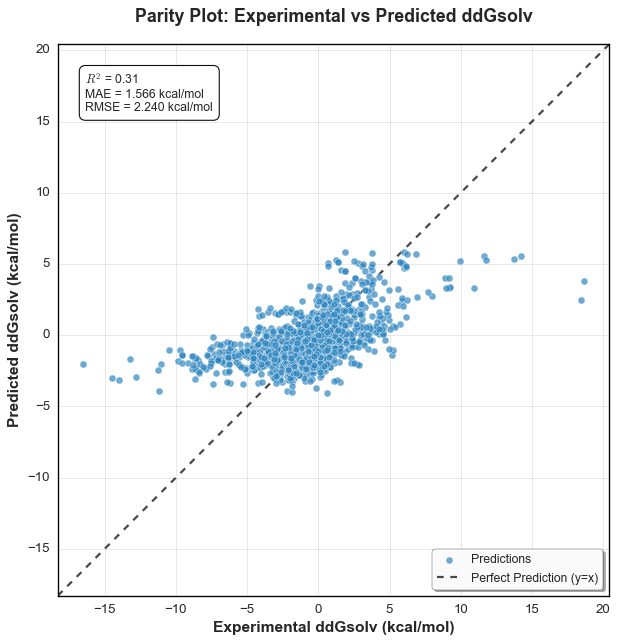


Model Performance Metrics for ddGsolv:
R² Score: 0.305
MAE: 1.566 kcal/mol
RMSE: 2.240 kcal/mol
Number of samples: 2009


(<Figure size 640x640 with 1 Axes>,
 <Axes: title={'center': 'Parity Plot: Experimental vs Predicted ddGsolv'}, xlabel='Experimental ddGsolv (kcal/mol)', ylabel='Predicted ddGsolv (kcal/mol)'>)

In [69]:
create_parity_plot(preds_path, s_test_path, column='ddGsolv')

### Task 1.3.2

##### Hyperparameter Optimisation (Optional)

This is optional for this file as i am using the Hyperparameter Optimisation from Chung's ESI - https://doi.org/10.1039/D3SC05353A

In [11]:
config_path = 'Hyper_opt/'

HyprArgs_C1 = [
    '--data_path', data_path,
    '--dataset_type', 'regression',
    '--smiles_columns', 'rxn_smiles', 'solvent_smiles',
    '--number_of_molecules','2',
    '--reaction_solvent',
    '--target_columns', 'ddGsolv', 'ddHsolv',
    '--num_iters', '47',
    '--search_parameter_keywords', 'all',
    '--config_save_path', config_path,
    '--epochs', '80',
    '--num_folds', '5',
    '--metric', 'rmse',
    '--num_workers','0',
    '--seed','123',
]

In [12]:
from chemprop.args import HyperoptArgs
from chemprop.hyperparameter_optimization import hyperopt

results_hyp = hyperopt(args=HyperoptArgs().parse_args(HyprArgs_C1))

Creating search space using parameters ['final_lr_ratio', 'activation', 'batch_size', 'aggregation_norm', 'hidden_size', 'max_lr', 'warmup_epochs', 'ffn_hidden_size', 'dropout', 'ffn_num_layers', 'init_lr_ratio', 'depth', 'aggregation'].
No manual trials loaded as part of hyperparameter search
Initiating trial with seed 0
Loaded 0 previous trials
Parameters assigned with random search, 23 random trials remaining


  0%|          | 0/1 [00:00<?, ?trial/s, best loss=?]

Command line
python c:\Users\Omary\miniconda3\envs\chemprop_official\lib\site-packages\ipykernel_launcher.py --f=c:\Users\Omary\AppData\Roaming\jupyter\runtime\kernel-v3729a67343be10604e717c660d3492f24b1c05c8a.json
Args
{'activation': 'SELU',
 'adding_bond_types': True,
 'adding_h': False,
 'aggregation': 'mean',
 'aggregation_norm': 108.0,
 'atom_constraints': [],
 'atom_descriptor_scaling': True,
 'atom_descriptors': None,
 'atom_descriptors_path': None,
 'atom_descriptors_size': 0,
 'atom_features_size': 0,
 'atom_messages': False,
 'atom_targets': [],
 'batch_size': 25,
 'bias': False,
 'bias_solvent': False,
 'bond_constraints': [],
 'bond_descriptor_scaling': True,
 'bond_descriptors': None,
 'bond_descriptors_path': None,
 'bond_descriptors_size': 0,
 'bond_features_size': 0,
 'bond_targets': [],
 'cache_cutoff': 10000,
 'checkpoint_dir': None,
 'checkpoint_frzn': None,
 'checkpoint_path': None,
 'checkpoint_paths': None,
 'class_balance': False,
 'config_path': None,
 'config_s

100%|██████████| 1/1 [2:06:19<00:00, 7579.70s/trial, best loss: 2.3899539896540847]

Initiating trial with seed 1
Loaded 1 previous trials
Parameters assigned with random search, 22 random trials remaining



 50%|█████     | 1/2 [00:00<?, ?trial/s, best loss=?]

Command line
python c:\Users\Omary\miniconda3\envs\chemprop_official\lib\site-packages\ipykernel_launcher.py --f=c:\Users\Omary\AppData\Roaming\jupyter\runtime\kernel-v3729a67343be10604e717c660d3492f24b1c05c8a.json
Args
{'activation': 'PReLU',
 'adding_bond_types': True,
 'adding_h': False,
 'aggregation': 'sum',
 'aggregation_norm': 119.0,
 'atom_constraints': [],
 'atom_descriptor_scaling': True,
 'atom_descriptors': None,
 'atom_descriptors_path': None,
 'atom_descriptors_size': 0,
 'atom_features_size': 0,
 'atom_messages': False,
 'atom_targets': [],
 'batch_size': 75,
 'bias': False,
 'bias_solvent': False,
 'bond_constraints': [],
 'bond_descriptor_scaling': True,
 'bond_descriptors': None,
 'bond_descriptors_path': None,
 'bond_descriptors_size': 0,
 'bond_features_size': 0,
 'bond_targets': [],
 'cache_cutoff': 10000,
 'checkpoint_dir': None,
 'checkpoint_frzn': None,
 'checkpoint_path': None,
 'checkpoint_paths': None,
 'class_balance': False,
 'config_path': None,
 'config_s

100%|██████████| 2/2 [1:34:09<00:00, 5649.28s/trial, best loss: 2.3899539896540847]

Initiating trial with seed 2
Loaded 2 previous trials
Parameters assigned with random search, 21 random trials remaining



 67%|██████▋   | 2/3 [00:00<?, ?trial/s, best loss=?]

Command line
python c:\Users\Omary\miniconda3\envs\chemprop_official\lib\site-packages\ipykernel_launcher.py --f=c:\Users\Omary\AppData\Roaming\jupyter\runtime\kernel-v3729a67343be10604e717c660d3492f24b1c05c8a.json
Args
{'activation': 'ELU',
 'adding_bond_types': True,
 'adding_h': False,
 'aggregation': 'sum',
 'aggregation_norm': 4.0,
 'atom_constraints': [],
 'atom_descriptor_scaling': True,
 'atom_descriptors': None,
 'atom_descriptors_path': None,
 'atom_descriptors_size': 0,
 'atom_features_size': 0,
 'atom_messages': False,
 'atom_targets': [],
 'batch_size': 45,
 'bias': False,
 'bias_solvent': False,
 'bond_constraints': [],
 'bond_descriptor_scaling': True,
 'bond_descriptors': None,
 'bond_descriptors_path': None,
 'bond_descriptors_size': 0,
 'bond_features_size': 0,
 'bond_targets': [],
 'cache_cutoff': 10000,
 'checkpoint_dir': None,
 'checkpoint_frzn': None,
 'checkpoint_path': None,
 'checkpoint_paths': None,
 'class_balance': False,
 'config_path': None,
 'config_save_

 67%|██████▋   | 2/3 [1:12:27<?, ?trial/s, best loss=?]


KeyboardInterrupt: 

In [ ]:
from chemprop.args import TrainArgs
from chemprop.train import cross_validate, run_training

TrainArgs_C1 = [
    '--data_path', data_path,
    '--separate_val_path',s_val_path,
    '--dataset_type', 'regression',
    '--save_dir', model_dir_C1,
    '--config_path', config_path,
    '--epochs', '80', # Specified by Paper to be 80
    '--ensemble_size', '5', # training multiple models for an ensembled - specified in Paper
    '--smiles_columns', 'rxn_smiles', 'solvent_smiles', # Specifies smiles columns - reaction and solvent
    '--reaction_solvent', # This is to ensure the model sees this as a reaction in presence of a solvent
    '--number_of_molecules', '2', # Number of Molecules
    '--target_columns', 'ddGsolv', 'ddHsolv', # Targetted Columns
    '--metric', 'rmse',
    '--extra_metrics', 'r2','mae',
    '--num_workers', '0'  # Ensure to specify -> Larger values may cause data leakage
]

P_TrainArgs_C1 = TrainArgs().parse_args(TrainArgs_C1)
results = cross_validate(args=P_TrainArgs_C1, train_func=run_training)

NameError: name 'data_path' is not defined

## Task 1.4

##### Fine-tuning


--- Overall Dataset Summary ---
Total Data Points:         46122
Number of Unique Reactions:  1870
Number of Unique Solvents:   295
count    1870.000000
mean       24.664171
std         1.535926
min        12.000000
25%        25.000000
50%        25.000000
75%        25.000000
max        25.000000


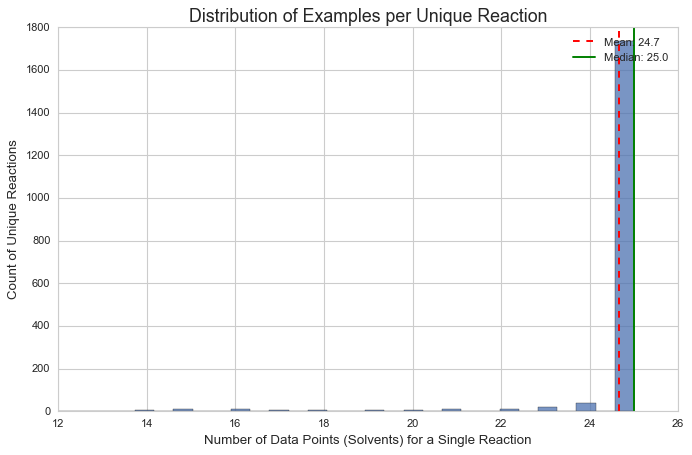

A good starting value for `NUM_REACTIONS_TO_KEEP` would be around 5000 / 24.7 = 203.


In [49]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os

# --- Configuration ---
# IMPORTANT: Update this path to your fine-tuning data file
SOURCE_DATA_PATH = 'Data/Finetuning/finetuning_rxn_solvent_ddGsolv_ddHsolv_chosen.csv'
REACTION_SMILES_COLUMN = 'rxn_smiles' 
SOLVENT_SMILES_COLUMN = 'solvent_smiles'

df = pd.read_csv(SOURCE_DATA_PATH)

# --- 1. Overall Dataset Summary ---
total_points = len(df)
num_unique_reactions = df[REACTION_SMILES_COLUMN].nunique()
num_unique_solvents = df[SOLVENT_SMILES_COLUMN].nunique()

print("\n--- Overall Dataset Summary ---")
print(f"Total Data Points:         {total_points}")
print(f"Number of Unique Reactions:  {num_unique_reactions}")
print(f"Number of Unique Solvents:   {num_unique_solvents}")

# This tells us how many examples (solvent pairings) each unique reaction has
reaction_counts = df[REACTION_SMILES_COLUMN].value_counts()
distribution_summary = reaction_counts.describe()
print(distribution_summary.to_string())

# --- 3. Visualization ---
plt.style.use('seaborn-v0_8-whitegrid')
fig, ax = plt.subplots(figsize=(10, 6))

sns.histplot(reaction_counts, bins=30, ax=ax, kde=False)

# Add lines for mean and median for context
mean_val = reaction_counts.mean()
median_val = reaction_counts.median()
ax.axvline(mean_val, color='red', linestyle='--', label=f'Mean: {mean_val:.1f}')
ax.axvline(median_val, color='green', linestyle='-', label=f'Median: {median_val:.1f}')

ax.set_title('Distribution of Examples per Unique Reaction', fontsize=16)
ax.set_xlabel('Number of Data Points (Solvents) for a Single Reaction', fontsize=12)
ax.set_ylabel('Count of Unique Reactions', fontsize=12)
ax.legend()
plt.show()

print(f"A good starting value for `NUM_REACTIONS_TO_KEEP` would be around 5000 / {mean_val:.1f} = {5000 / mean_val:.0f}.")

In [ ]:
import pandas as pd
import numpy as np
import os

#  Configuration 
SOURCE_DATA_PATH = 'Data/Finetuning/finetuning_rxn_solvent_ddGsolv_ddHsolv_chosen.csv'
SPLIT_DIR = 'data_splits/C1-F'
TARGET_DATA_SIZE = 7500
NUM_REACTIONS_TO_KEEP = 305
REACTION_SMILES_COLUMN = 'rxn_smiles'

# Setup 
os.makedirs(SPLIT_DIR, exist_ok=True)
df_full = pd.read_csv(SOURCE_DATA_PATH)

all_unique_reactions = df_full[REACTION_SMILES_COLUMN].unique()
np.random.seed(42) # for reproducibility
if len(all_unique_reactions) < NUM_REACTIONS_TO_KEEP:
    print(f"Warning: Number of unique reactions ({len(all_unique_reactions)}) is less than NUM_REACTIONS_TO_KEEP ({NUM_REACTIONS_TO_KEEP}). Using all available reactions.")
    selected_reactions = all_unique_reactions
else:
    selected_reactions = np.random.choice(all_unique_reactions, NUM_REACTIONS_TO_KEEP, replace=False)

# Create a Data Pool from Selected Reactions
df_pool = df_full[df_full[REACTION_SMILES_COLUMN].isin(selected_reactions)]

# Downsample the Pool to the Target Size
if len(df_pool) > TARGET_DATA_SIZE:
    df_sample = df_pool.sample(n=TARGET_DATA_SIZE, random_state=42)
else:
    print(f"Warning: The data pool from selected reactions has {len(df_pool)} rows, which is less than the TARGET_DATA_SIZE of {TARGET_DATA_SIZE}. Using the entire pool.")
    df_sample = df_pool

# Get unique reactions *within our final sample*
unique_reactions_in_sample = df_sample[REACTION_SMILES_COLUMN].unique()
np.random.shuffle(unique_reactions_in_sample) # Shuffle again for the split

# --- NEW: Split the list of reactions 80/10/10 for train/validation/test ---
n_reactions = len(unique_reactions_in_sample)
train_end_idx = int(0.8 * n_reactions)
val_end_idx = int(0.9 * n_reactions) # 80% for train + 10% for validation

train_rxns = set(unique_reactions_in_sample[:train_end_idx])
val_rxns = set(unique_reactions_in_sample[train_end_idx:val_end_idx])
test_rxns = set(unique_reactions_in_sample[val_end_idx:])

# Create the final dataframes
df_train = df_sample[df_sample[REACTION_SMILES_COLUMN].isin(train_rxns)]
df_val = df_sample[df_sample[REACTION_SMILES_COLUMN].isin(val_rxns)]
df_test = df_sample[df_sample[REACTION_SMILES_COLUMN].isin(test_rxns)]


# Save the Split Files
train_path = os.path.join(SPLIT_DIR, 'train.csv')
val_path = os.path.join(SPLIT_DIR, 'val.csv')
test_path = os.path.join(SPLIT_DIR, 'test.csv') # New path for the test file

df_train.to_csv(train_path, index=False)
df_val.to_csv(val_path, index=False)
df_test.to_csv(test_path, index=False) # Save the test file

print("\nData successfully split and saved for a medium fine-tuning run:")
print(f"  Train set:      {len(df_train):>5} rows -> {train_path}")
print(f"  Validation set: {len(df_val):>5} rows -> {val_path}")
print(f"  Test set:       {len(df_test):>5} rows -> {test_path}")
print(f"  -------------------------------------")
print(f"  Total points:   {len(df_train) + len(df_val) + len(df_test)}")
print(f"  Reaction split: {len(train_rxns)} train / {len(val_rxns)} val / {len(test_rxns)} test")


Data successfully split and saved for a medium fine-tuning run:
  Train set:       5985 rows -> data_splits/C1-F/train.csv
  Validation set:   745 rows -> data_splits/C1-F/val.csv
  Test set:         770 rows -> data_splits/C1-F/test.csv
  -------------------------------------
  Total points:   7500
  Reaction split: 244 train / 30 val / 31 test


In [ ]:
model_dir_F_C1 = 'Models/C1_F-Model'
model_dir_C1 = 'Models/C1_P-Model'
config_path = 'Hyper_opt/Hyperopt.json'

FineArgs_C1 = [
    '--data_path', train_path,
    '--separate_val_path', val_path,
    '--dataset_type', 'regression',
    '--target_columns', 'ddGsolv', 'ddHsolv',
    '--smiles_columns', 'rxn_smiles', 'solvent_smiles',
    '--reaction_solvent',
    '--number_of_molecules', '2',
    '--checkpoint_dir', model_dir_C1,
    '--save_dir', model_dir_F_C1,
    # '--config_path', config_path,
    # '--ffn_num_layers', '2',
    # '--ffn_hidden_size', '600',
    # '--hidden_size', '700',
    # '--init_lr', '1e-5',                                # ADDED: Low learning rate
    # '--max_lr', '1e-5',                                 # ADDED
    # '--final_lr', '1e-8',   
    '--freeze_first_only',
    '--epochs','10',
    '--num_folds','1',
    '--metric', 'rmse',
    '--extra_metrics', 'mae', 'r2',
    '--num_workers', '0',
    '--seed', '123'
    ]

In [ ]:
from chemprop.args import TrainArgs
from chemprop.train import cross_validate, run_training

F_TrainArgs_C1 = TrainArgs().parse_args(FineArgs_C1)
results = cross_validate(args=F_TrainArgs_C1, train_func=run_training)

Command line
python c:\Users\Omary\miniconda3\envs\chemprop_official\lib\site-packages\ipykernel_launcher.py --f=c:\Users\Omary\AppData\Roaming\jupyter\runtime\kernel-v3b3fab9d0f38833b28509a78cdc6616b62b6149fe.json
Args
{'activation': 'ReLU',
 'adding_bond_types': True,
 'adding_h': False,
 'aggregation': 'mean',
 'aggregation_norm': 100,
 'atom_constraints': [],
 'atom_descriptor_scaling': True,
 'atom_descriptors': None,
 'atom_descriptors_path': None,
 'atom_descriptors_size': 0,
 'atom_features_size': 0,
 'atom_messages': False,
 'atom_targets': [],
 'batch_size': 50,
 'bias': False,
 'bias_solvent': False,
 'bond_constraints': [],
 'bond_descriptor_scaling': True,
 'bond_descriptors': None,
 'bond_descriptors_path': None,
 'bond_descriptors_size': 0,
 'bond_features_size': 0,
 'bond_targets': [],
 'cache_cutoff': 10000,
 'checkpoint_dir': 'Models/C1_P-Model',
 'checkpoint_frzn': None,
 'checkpoint_path': None,
 'checkpoint_paths': ['Models/C1_P-Model\\fold_0\\model_0\\model.pt',
 

### Task 1.4.1

##### Predicting using Finetuning

In [43]:
# test_path_F = 'data_splits/Experimental/experimental_test_for_prediction.csv'
preds_path_F = 'Data/Pred/F_Predicted_Data.csv'


model_dir_C1 = 'Models/C1_P-Model'
model_dir_F_C1 = 'Models/C1_F-Model'

PredArgs_C1_F = [
    '--test_path', test_path,
    '--preds_path', preds_path_F,
    '--checkpoint_dir', model_dir_F_C1,
    '--smiles_columns', 'rxn_smiles', 'solvent_smiles',
    '--number_of_molecules', '2',
    '--num_workers', '0',
]

In [4]:
import chemprop
from chemprop.args import TrainArgs
from chemprop.train import cross_validate, run_training

args = chemprop.args.PredictArgs().parse_args(PredArgs_C1_F)
preds = chemprop.train.make_predictions(args=args)

Loading training args
Setting molecule featurization parameters to default.
Loading data


770it [00:00, 307406.63it/s]
100%|██████████| 770/770 [00:00<00:00, 256420.33it/s]
[18:00:14] WARNING: not removing hydrogen atom without neighbors
[18:00:14] WARNING: not removing hydrogen atom without neighbors
[18:00:14] WARNING: not removing hydrogen atom without neighbors
[18:00:14] WARNING: not removing hydrogen atom without neighbors
[18:00:14] WARNING: not removing hydrogen atom without neighbors


Validating SMILES
Test size = 770


  0%|          | 0/25 [00:00<?, ?it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


  4%|▍         | 1/25 [00:00<00:21,  1.11it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


  8%|▊         | 2/25 [00:01<00:13,  1.72it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 12%|█▏        | 3/25 [00:01<00:10,  2.08it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 16%|█▌        | 4/25 [00:01<00:09,  2.32it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 20%|██        | 5/25 [00:02<00:08,  2.33it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 24%|██▍       | 6/25 [00:02<00:07,  2.46it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 28%|██▊       | 7/25 [00:03<00:07,  2.55it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 32%|███▏      | 8/25 [00:03<00:06,  2.60it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 36%|███▌      | 9/25 [00:03<00:06,  2.50it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 40%|████      | 10/25 [00:04<00:05,  2.52it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 44%|████▍     | 11/25 [00:04<00:05,  2.60it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 48%|████▊     | 12/25 [00:05<00:04,  2.67it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 52%|█████▏    | 13/25 [00:05<00:04,  2.59it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 56%|█████▌    | 14/25 [00:05<00:04,  2.65it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 60%|██████    | 15/25 [00:06<00:03,  2.67it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 64%|██████▍   | 16/25 [00:06<00:03,  2.68it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 68%|██████▊   | 17/25 [00:06<00:03,  2.54it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 72%|███████▏  | 18/25 [00:07<00:02,  2.61it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 76%|███████▌  | 19/25 [00:07<00:02,  2.67it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 80%|████████  | 20/25 [00:08<00:01,  2.70it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 84%|████████▍ | 21/25 [00:08<00:01,  2.57it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 88%|████████▊ | 22/25 [00:08<00:01,  2.56it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 92%|█████████▏| 23/25 [00:09<00:00,  2.54it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 96%|█████████▌| 24/25 [00:09<00:00,  2.56it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


100%|██████████| 25/25 [00:10<00:00,  2.46it/s]

Saving predictions to Data/Pred/F_Predicted_Data.csv
Elapsed time = 0:00:10


In [ ]:
preds_path_F = 'Data/Pred/F_Predicted_Data.csv'

create_parity_plot(preds_path_F, test_path, column='ddGsolv')

NameError: name 'preds_path_F' is not defined

In [ ]:
# test_path_F = 'data_splits/Experimental/experimental_test_for_prediction.csv'
s_test_path = 'data_splits/C1/test.csv'
preds_path = 'Data/Pred/F_1_Predicted_Data.csv'

model_dir_C1 = 'Models/C1_P-Model'

PredArgs_C1_F = [
    '--test_path', s_test_path,
    '--preds_path', preds_path,
    '--checkpoint_dir', model_dir_C1,
    '--smiles_columns', 'rxn_smiles', 'solvent_smiles',
    '--number_of_molecules', '2',
    '--num_workers', '0',
]

import chemprop
from chemprop.args import TrainArgs
from chemprop.train import cross_validate, run_training

args = chemprop.args.PredictArgs().parse_args(PredArgs_C1_F)
preds = chemprop.train.make_predictions(args=args)

Loading training args
Setting molecule featurization parameters to default.
Loading data


1983it [00:00, 263731.64it/s]
100%|██████████| 1983/1983 [00:00<00:00, 264007.90it/s]


Validating SMILES
Test size = 1,983


  0%|          | 0/25 [00:00<?, ?it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


  4%|▍         | 1/25 [00:01<00:25,  1.05s/it]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


  8%|▊         | 2/25 [00:01<00:21,  1.06it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 12%|█▏        | 3/25 [00:02<00:20,  1.09it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 16%|█▌        | 4/25 [00:03<00:20,  1.04it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 20%|██        | 5/25 [00:04<00:18,  1.06it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 24%|██▍       | 6/25 [00:05<00:17,  1.07it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 28%|██▊       | 7/25 [00:06<00:16,  1.08it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 32%|███▏      | 8/25 [00:07<00:15,  1.08it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 36%|███▌      | 9/25 [00:08<00:14,  1.08it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 40%|████      | 10/25 [00:09<00:13,  1.08it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 44%|████▍     | 11/25 [00:10<00:13,  1.05it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 48%|████▊     | 12/25 [00:11<00:12,  1.06it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 52%|█████▏    | 13/25 [00:12<00:11,  1.07it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 56%|█████▌    | 14/25 [00:13<00:10,  1.08it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 60%|██████    | 15/25 [00:14<00:09,  1.08it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 64%|██████▍   | 16/25 [00:15<00:08,  1.03it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 68%|██████▊   | 17/25 [00:15<00:07,  1.06it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 72%|███████▏  | 18/25 [00:16<00:06,  1.07it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 76%|███████▌  | 19/25 [00:17<00:05,  1.07it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 80%|████████  | 20/25 [00:18<00:04,  1.07it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 84%|████████▍ | 21/25 [00:19<00:03,  1.09it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 88%|████████▊ | 22/25 [00:20<00:02,  1.10it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 92%|█████████▏| 23/25 [00:21<00:01,  1.07it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 96%|█████████▌| 24/25 [00:22<00:00,  1.08it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


100%|██████████| 25/25 [00:23<00:00,  1.07it/s]

Saving predictions to Data/Pred/F_1_Predicted_Data.csv
Elapsed time = 0:00:24


In [73]:
s_test_path = 'data_splits/C1/test.csv'
preds_path = 'Data/Pred/F_1_Predicted_Data.csv'
create_parity_plot(preds_path, s_test_path, column='ddGsolv')

ValueError: Found input variables with inconsistent numbers of samples: [2009, 1983]

# Task 2

Finetune Chung Model with Radical Reactions in mind

Note: The dataset in use is sourced from Spiekermann et al (2024) -> to compare the performance of Chung's Model with 

# Task 2.1

Data-Cleaning

In [ ]:
import pandas as pd
import os
import numpy as np 

curr_dir = os.getcwd()
path = os.path.join(curr_dir, 'Data', 'Radical','all_rxn_all_solvent_bidirection_resonance.csv')
df = pd.read_csv(path)
print("Successfully loaded the dataset.")

columns_to_select = [
    'rxn_smi',
    'solvent_smi',
    'DeltaDeltaG_ET_solv_molar_kcal_mol',
    'rxn_idx'
]

df_selected = df[columns_to_select]
new_column_names = {
    'rxn_idx' : 'rxn_type',
    'rxn_smi': 'rxn_smiles',
    'solvent_smi': 'solvent_smiles',
    'DeltaDeltaG_ET_solv_molar_kcal_mol': 'ddGsolv'
}

df_cleaned = df_selected.rename(columns=new_column_names)
# We use np.nan which is the standard for missing numerical data in pandas.
df_cleaned['ddHsolv'] = np.nan
final_column_order = [
    'rxn_type',
    'rxn_smiles',
    'solvent_smiles',
    'ddGsolv',
    'ddHsolv'
]
df_final = df_cleaned[final_column_order]
output_filename = 'Data/Radical/Sampled/Big_Dataset.csv'
output_dir = os.path.dirname(output_filename)
if not os.path.exists(output_dir):
    os.makedirs(output_dir)
df_final.to_csv(output_filename, index=False)


# --- Final Output ---
print("\nCleaned DataFrame Head with final column order:")

display(df_final.head())
print(f"\nFinal column order: {df_final.columns.to_list()}")
print(f"Shape of the final DataFrame: {df_final.shape}")
print(f"\nSuccessfully saved the cleaned data to '{output_filename}'")

Successfully loaded the dataset.

Cleaned DataFrame Head with final column order:


,rxn_type,rxn_smiles,solvent_smiles,ddGsolv,ddHsolv
0,0,[C:1]([C:2]([H:5])([H:6])[O:7][O:8][H:9])([H:3...,C1COCCO1,-1.377066,NaN
1,0,[C:1]([C:2]([H:5])([H:6])[O:7][O:8][H:9])([H:3...,CCCCC(CC)CO,-1.089753,NaN
2,0,[C:1]([C:2]([H:5])([H:6])[O:7][O:8][H:9])([H:3...,CC(=O)O,-1.116370,NaN
3,0,[C:1]([C:2]([H:5])([H:6])[O:7][O:8][H:9])([H:3...,CC(C)=O,-1.345333,NaN
4,0,[C:1]([C:2]([H:5])([H:6])[O:7][O:8][H:9])([H:3...,CC#N,-1.340735,NaN



Final column order: ['rxn_type', 'rxn_smiles', 'solvent_smiles', 'ddGsolv', 'ddHsolv']
Shape of the final DataFrame: (1863360, 5)

Successfully saved the cleaned data to 'Data/Radical/Sampled/Big_Dataset.csv'


In [ ]:
import pandas as pd
import os
import numpy as np # Added for np.nan
from sklearn.model_selection import train_test_split

# Load your dataset 
curr_dir = os.getcwd()
path = os.path.join(curr_dir, 'Data', 'Radical', 'all_rxn_all_solvent_bidirection_resonance.csv')
df = pd.read_csv(path)
n_samples = 16000

df_sampled, _ = train_test_split(
    df,
    train_size=n_samples,
    stratify=df['rxn_idx'], # Stratify based on the reaction type column
    random_state=43      # for reproducible results
)
columns_to_process = [
    'rxn_idx',
    'rxn_smi',
    'solvent_smi',
    'DeltaDeltaG_ET_solv_molar_kcal_mol'
]
# Using .copy() to avoid a SettingWithCopyWarning later
df_selected = df_sampled[columns_to_process].copy()

new_column_names = {
    'rxn_idx': 'rxn_type', # Changed to 'rxn_type' for consistency
    'rxn_smi': 'rxn_smiles',
    'solvent_smi': 'solvent_smiles',
    'DeltaDeltaG_ET_solv_molar_kcal_mol': 'ddGsolv'
}

# Rename the columns
df_renamed = df_selected.rename(columns=new_column_names)

# Add the 'ddHsolv' column with empty values
df_renamed['ddHsolv'] = np.nan

# Define and enforce the final column order
final_column_order = [
    'rxn_type',
    'rxn_smiles',
    'solvent_smiles',
    'ddGsolv',
    'ddHsolv'
]
df_final = df_renamed[final_column_order]

#  Reset the index of the final dataframe for a clean output
df_final.reset_index(drop=True, inplace=True)
output_filename = 'Data/Radical/Sampled/Stratified_Sample.csv'
output_dir = os.path.dirname(output_filename)
df_final.to_csv(output_filename, index=False)

print("\nFinal DataFrame Head (as it will appear in the CSV):")
display(df_final.head()) 
print(f"\nFinal column order: {df_final.columns.to_list()}")
print(f"Shape of the final DataFrame: {df_final.shape}")
print(f"\nSuccessfully saved the final data to '{output_filename}'")

Successfully loaded the dataset with 1863360 rows.

--- Performing stratified sampling to get 12,000 data points ---
Sampled DataFrame created with 16000 rows.

Final DataFrame Head (as it will appear in the CSV):


,rxn_type,rxn_smiles,solvent_smiles,ddGsolv,ddHsolv
0,1011,[C:14]([O:15][C:16](=[O:17])[C:18](=[C:19]([H:...,C1CCNCC1,-0.354084,NaN
1,3613,[C:1]([C:2]([C:3]([C:4]([H:14])([H:15])[H:16])...,O=Cc1ccccc1,-0.174915,NaN
2,3386,[C:1]([C:2]([C:3]([H:8])([H:9])[C:15]([C:14]([...,ClCCl,-0.642687,NaN
3,1686,[C:15](=[C:16]([c:17]1[c:18]([H:26])[c:19]([H:...,Cc1ccccc1,-0.047216,NaN
4,1746,[C:17]([C:18]([H:26])([H:27])[H:28])([C:19]([H...,CO,-0.575833,NaN



Final column order: ['rxn_type', 'rxn_smiles', 'solvent_smiles', 'ddGsolv', 'ddHsolv']
Shape of the final DataFrame: (16000, 5)

Successfully saved the final data to 'Data/Radical/Sampled/Stratified_Sample.csv'


Loading the full dataset from 'Data\Radical\all_rxn_all_solvent_bidirection_resonance.csv'...

--- Frequency Analysis ---
Total number of data points: 1863360
Number of unique reaction types: 5600
Most frequent reaction type appears 5120 times.
Least frequent reaction type appears 80 times.
--------------------------

Generating histogram...
Histogram saved successfully to 'reaction_type_frequency_histogram.png'


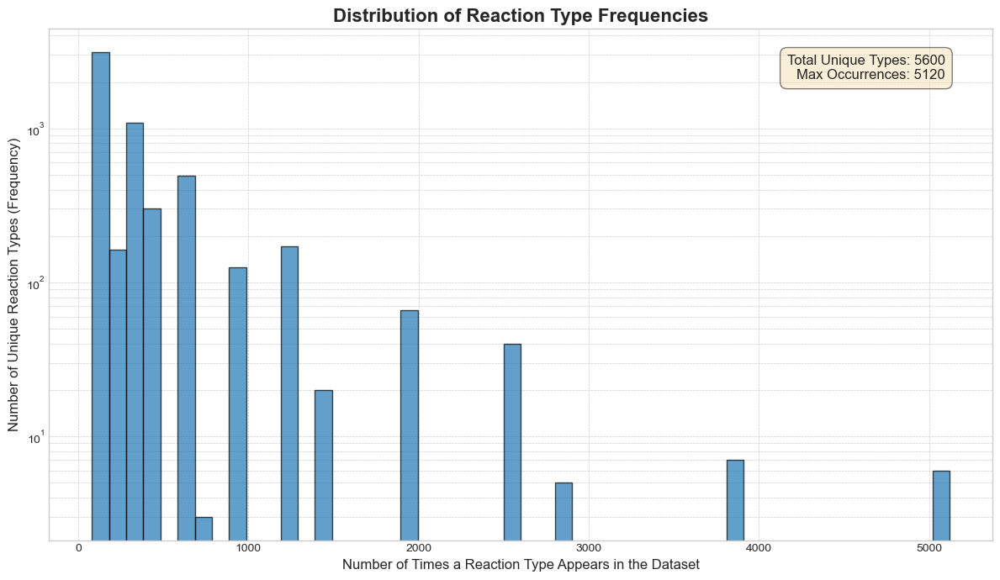

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import os

# Path to your full, original dataset
full_dataset_path = os.path.join('Data','Radical', 'all_rxn_all_solvent_bidirection_resonance.csv')
reaction_id_col = 'rxn_idx'
output_plot_file = 'reaction_type_frequency_histogram.png'

# Load Data
print(f"Loading the full dataset from '{full_dataset_path}'...")
df_full = pd.read_csv(full_dataset_path)

# Calculate Frequencies
# Get the number of times each unique rxn_idx appears
reaction_counts = df_full[reaction_id_col].value_counts()

print("\n--- Frequency Analysis ---")
print(f"Total number of data points: {len(df_full)}")
print(f"Number of unique reaction types: {len(reaction_counts)}")
print(f"Most frequent reaction type appears {reaction_counts.max()} times.")
print(f"Least frequent reaction type appears {reaction_counts.min()} times.")
print("--------------------------\n")

#  Create the Histogram
print("Generating histogram...")
plt.style.use('seaborn-v0_8-whitegrid')
fig, ax = plt.subplots(figsize=(12, 7))

# Plot a histogram of the counts themselves
ax.hist(reaction_counts, bins=50, edgecolor='black', alpha=0.7)

# Set plot labels and title
ax.set_title('Distribution of Reaction Type Frequencies', fontsize=16, fontweight='bold')
ax.set_xlabel('Number of Times a Reaction Type Appears in the Dataset', fontsize=12)
ax.set_ylabel('Number of Unique Reaction Types (Frequency)', fontsize=12)

# Use a logarithmic scale for the y-axis to better visualize the distribution,
# as many types will have low counts.
ax.set_yscale('log')
ax.grid(True, which='both', linestyle='--', linewidth=0.5)
# Add text with key stats
stats_text = (f'Total Unique Types: {len(reaction_counts)}\n'
                f'Max Occurrences: {reaction_counts.max()}')
ax.text(0.95, 0.95, stats_text, transform=ax.transAxes, fontsize=12,
        verticalalignment='top', horizontalalignment='right',
        bbox=dict(boxstyle='round,pad=0.5', fc='wheat', alpha=0.5))

plt.tight_layout()

plt.savefig(output_plot_file, dpi=300)
print(f"Histogram saved successfully to '{output_plot_file}'")
plt.show()


Loading the 16,000-point sample from 'Data\Radical\Sampled\Stratified_Sample.csv'...

--- Frequency Analysis of the 16,000-Point Sample ---
Total number of data points: 16,000
Number of unique reaction types: 5,555
Most frequent reaction type appears 44 times.
Least frequent reaction type appears 1 times.
----------------------------------------------------

Generating histogram...
Histogram saved successfully to 'sample_16k_frequency_histogram.png'


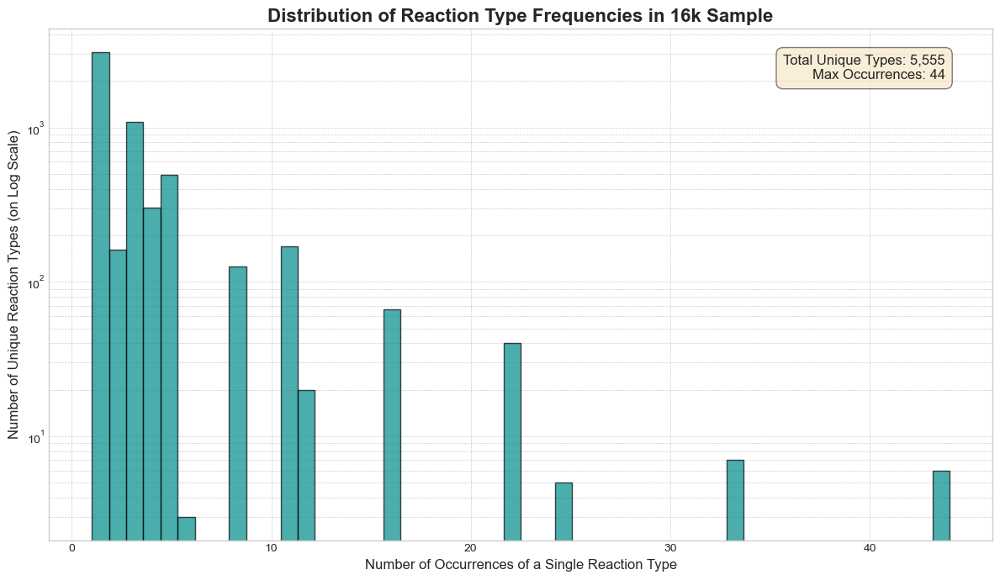

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import os


sample_file_path = os.path.join('Data', 'Radical', 'Sampled', 'Stratified_Sample.csv')
reaction_type_col = 'rxn_type' 
output_plot_file = 'sample_16k_frequency_histogram.png'

print(f"Loading the 16,000-point sample from '{sample_file_path}'...")
df_sample = pd.read_csv(sample_file_path)

# Calculate Frequencies 
# Get the number of times each unique reaction type appears in the sample
reaction_counts = df_sample[reaction_type_col].value_counts()

print("\n--- Frequency Analysis of the 16,000-Point Sample ---")
print(f"Total number of data points: {len(df_sample):,}")
print(f"Number of unique reaction types: {len(reaction_counts):,}")
print(f"Most frequent reaction type appears {reaction_counts.max()} times.")
print(f"Least frequent reaction type appears {reaction_counts.min()} times.")
print("----------------------------------------------------\n")

# Create the Histogram
print("Generating histogram...")
plt.style.use('seaborn-v0_8-whitegrid')
fig, ax = plt.subplots(figsize=(12, 7)
ax.hist(reaction_counts, bins=50, edgecolor='black', alpha=0.7, color='darkcyan')
ax.set_title('Distribution of Reaction Type Frequencies in 16k Sample', fontsize=16, fontweight='bold')
ax.set_xlabel('Number of Occurrences of a Single Reaction Type', fontsize=12)
ax.set_ylabel('Number of Unique Reaction Types (on Log Scale)', fontsize=12)
ax.set_yscale('log')
ax.grid(True, which='both', linestyle='--', linewidth=0.5)
stats_text = (f'Total Unique Types: {len(reaction_counts):,}\n'
                f'Max Occurrences: {reaction_counts.max()}')
ax.text(0.95, 0.95, stats_text, transform=ax.transAxes, fontsize=12,
        verticalalignment='top', horizontalalignment='right',
        bbox=dict(boxstyle='round,pad=0.5', fc='wheat', alpha=0.5))
plt.tight_layout()

# Save and Show the Plot
plt.savefig(output_plot_file, dpi=300)
print(f"Histogram saved successfully to '{output_plot_file}'")
plt.show()

In [ ]:
import pandas as pd
import numpy as np
import os

SOURCE_DATA_PATH = 'Data/Radical/Sampled/Stratified_Sample.csv'
SPLIT_DIR = 'data_splits/C1-R-F'
REACTION_SMILES_COLUMN = 'rxn_smiles'

# Setup and Data Loading 
os.makedirs(SPLIT_DIR, exist_ok=True)
print(f"Loading full dataset from '{SOURCE_DATA_PATH}' to be split...")
df_full = pd.read_csv(SOURCE_DATA_PATH)
print(f"Successfully loaded {len(df_full):,} rows.")

# Get All Unique Reactions from the Dataset 
all_unique_reactions = df_full[REACTION_SMILES_COLUMN].unique()
print(f"Found {len(all_unique_reactions):,} unique reactions to be split.")
# Set a seed and shuffle the reactions for a random split
np.random.seed(42)
np.random.shuffle(all_unique_reactions)

# Split Reactions into Train/Validation/Test Sets (72/18/10)
n_reactions = len(all_unique_reactions)
train_end_idx = int(0.72 * n_reactions)
val_end_idx = int((0.72 + 0.18) * n_reactions) # Cumulative point is 90%

# Create sets of reaction SMILES for each split
train_rxns = set(all_unique_reactions[:train_end_idx])
val_rxns = set(all_unique_reactions[train_end_idx:val_end_idx])
test_rxns = set(all_unique_reactions[val_end_idx:])

print("\nSplitting reactions into sets:")
print(f"  Train reactions:      {len(train_rxns)}")
print(f"  Validation reactions: {len(val_rxns)}")
print(f"  Test reactions:       {len(test_rxns)}")

# Filter the original DataFrame based on the reaction sets
print("\nCreating final dataframes based on reaction splits...")
df_train = df_full[df_full[REACTION_SMILES_COLUMN].isin(train_rxns)]
df_val = df_full[df_full[REACTION_SMILES_COLUMN].isin(val_rxns)]
df_test = df_full[df_full[REACTION_SMILES_COLUMN].isin(test_rxns)]

# Define paths for saving
train_path = os.path.join(SPLIT_DIR, 'train.csv')
val_path = os.path.join(SPLIT_DIR, 'val.csv')
test_path = os.path.join(SPLIT_DIR, 'test.csv')

# Save the files
df_train.to_csv(train_path, index=False)
df_val.to_csv(val_path, index=False)
df_test.to_csv(test_path, index=False)


# --- Final Report ---
print("\nData successfully split and saved:")
print(f"  Train set:      {len(df_train):>5} rows -> {train_path}")
print(f"  Validation set: {len(df_val):>5} rows -> {val_path}")
print(f"  Test set:       {len(df_test):>5} rows -> {test_path}")
print(f"  -------------------------------------")
total_points = len(df_train) + len(df_val) + len(df_test)
print(f"  Total points in splits: {total_points} (Should equal original file size: {len(df_full)})")
print(f"  Reaction split (72/18/10): {len(train_rxns)} train / {len(val_rxns)} val / {len(test_rxns)} test")

Loading full dataset from 'Data/Radical/Sampled/Stratified_Sample.csv' to be split...
Successfully loaded 16,000 rows.
Found 14,367 unique reactions to be split.

Splitting reactions into sets:
  Train reactions:      10344
  Validation reactions: 2586
  Test reactions:       1437

Creating final dataframes based on reaction splits...

Data successfully split and saved:
  Train set:      11513 rows -> data_splits/C1-R-F\train.csv
  Validation set:  2874 rows -> data_splits/C1-R-F\val.csv
  Test set:        1613 rows -> data_splits/C1-R-F\test.csv
  -------------------------------------
  Total points in splits: 16000 (Should equal original file size: 16000)
  Reaction split (72/18/10): 10344 train / 2586 val / 1437 test


# Task 2.2

Performance of Radical Reactions

In [ ]:
import chemprop

# ReRUN
r_test_path = 'data_splits/C1-R-F/test.csv'
r_preds_path = 'Data/Pred/F-R-Pre-Predicted_Data.csv'
model_dir_F_C1 = 'Models/C1_F-Model'


arguments = [
    '--test_path', r_test_path,
    '--preds_path', r_preds_path,
    '--checkpoint_dir', model_dir_F_C1,
    '--number_of_molecules', '2',
    '--smiles_columns', 'rxn_smiles','solvent_smiles',
    '--num_workers','0'
]


args = chemprop.args.PredictArgs().parse_args(arguments)
preds = chemprop.train.make_predictions(args=args)

Loading training args
Setting molecule featurization parameters to default.
Loading data


1613it [00:00, 20517.10it/s]
100%|██████████| 1613/1613 [00:00<00:00, 292989.15it/s]
[22:30:36] WARNING: not removing hydrogen atom without neighbors


Validating SMILES
Test size = 1,613


  0%|          | 0/25 [00:00<?, ?it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


  4%|▍         | 1/25 [00:02<00:59,  2.47s/it]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


  8%|▊         | 2/25 [00:03<00:35,  1.55s/it]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 12%|█▏        | 3/25 [00:04<00:27,  1.27s/it]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 16%|█▌        | 4/25 [00:05<00:23,  1.14s/it]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 20%|██        | 5/25 [00:06<00:22,  1.11s/it]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 24%|██▍       | 6/25 [00:07<00:20,  1.05s/it]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 28%|██▊       | 7/25 [00:08<00:18,  1.00s/it]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 32%|███▏      | 8/25 [00:09<00:16,  1.04it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 36%|███▌      | 9/25 [00:10<00:15,  1.02it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 40%|████      | 10/25 [00:10<00:14,  1.03it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 44%|████▍     | 11/25 [00:11<00:13,  1.04it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 48%|████▊     | 12/25 [00:12<00:12,  1.03it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 52%|█████▏    | 13/25 [00:13<00:11,  1.03it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 56%|█████▌    | 14/25 [00:14<00:10,  1.03it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 60%|██████    | 15/25 [00:15<00:10,  1.01s/it]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 64%|██████▍   | 16/25 [00:16<00:08,  1.01it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 68%|██████▊   | 17/25 [00:17<00:07,  1.03it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 72%|███████▏  | 18/25 [00:18<00:06,  1.04it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 76%|███████▌  | 19/25 [00:19<00:05,  1.01it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 80%|████████  | 20/25 [00:20<00:04,  1.03it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 84%|████████▍ | 21/25 [00:21<00:03,  1.05it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 88%|████████▊ | 22/25 [00:22<00:02,  1.06it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 92%|█████████▏| 23/25 [00:23<00:01,  1.07it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 96%|█████████▌| 24/25 [00:24<00:00,  1.02it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


100%|██████████| 25/25 [00:25<00:00,  1.02s/it]

Saving predictions to Data/Pred/F-R-Predicted_Data.csv
Elapsed time = 0:00:26


Loading calculated values from: data_splits/C1-R-F/test.csv
Loading predicted values from: Data/Pred/F-R-Predicted_Data.csv
Successfully loaded 1613 data points for comparison.

--- Performance Metrics ---
R-squared (R²): 0.0819
Mean Absolute Error (MAE): 1.1187
Root Mean Squared Error (RMSE): 1.6303
---------------------------

Generating parity plot...


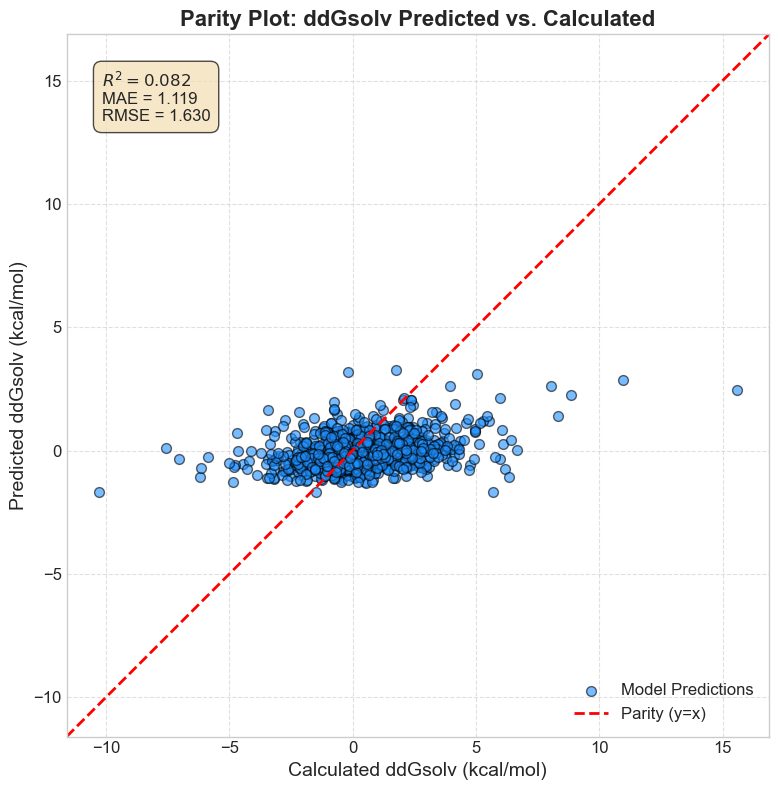

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import numpy as np

# --- 1. DEFINE YOUR FILE PATHS ---
# Paths you provided for the ground truth (test) and prediction data.
r_test_path = 'data_splits/C1-R-F/test.csv'
r_preds_path = 'Data/Pred/F-R-Predicted_Data.csv'

print(f"Loading calculated values from: {r_test_path}")
print(f"Loading predicted values from: {r_preds_path}")

# --- 2. LOAD DATA USING PANDAS ---
try:
    # Load the ground truth (calculated) data from the test set
    df_test = pd.read_csv(r_test_path)
    # Load the model's predictions
    df_preds = pd.read_csv(r_preds_path)
except FileNotFoundError as e:
    print(f"\nERROR: {e}")
    print("\nPlease make sure you are running this script from the correct parent directory,")
    print("so it can find both the 'data_splits' and 'Data' folders.")
    exit()

# --- 3. EXTRACT THE 'ddGsolv' COLUMNS ---
# It's crucial that these two series have the same number of rows and are correctly ordered.
try:
    # 'ddGsolv' from the test file are the "calculated" or true values
    ddGsolv_calc = df_test['ddGsolv']
    
    # 'ddGsolv' from the predictions file are the "predicted" values
    ddGsolv_pred = df_preds['ddGsolv']
except KeyError as e:
    print(f"\nERROR: Column 'ddGsolv' not found. {e}")
    print("Please ensure the column name is spelled correctly in both CSV files.")
    exit()


# Sanity check for data length
if len(ddGsolv_calc) != len(ddGsolv_pred):
    print(f"\nERROR: The number of data points do not match!")
    print(f"  Test data has {len(ddGsolv_calc)} rows.")
    print(f"  Prediction data has {len(ddGsolv_pred)} rows.")
    print("Please ensure the prediction file corresponds to the correct test set.")
    exit()
else:
    print(f"Successfully loaded {len(ddGsolv_calc)} data points for comparison.")

# --- 4. CALCULATE PERFORMANCE METRICS ---
r2 = r2_score(ddGsolv_calc, ddGsolv_pred)
mae = mean_absolute_error(ddGsolv_calc, ddGsolv_pred)
rmse = np.sqrt(mean_squared_error(ddGsolv_calc, ddGsolv_pred))

print("\n--- Performance Metrics ---")
print(f"R-squared (R²): {r2:.4f}")
print(f"Mean Absolute Error (MAE): {mae:.4f}")
print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")
print("---------------------------\n")


# --- 5. CREATE THE PARITY PLOT ---
print("Generating parity plot...")
fig, ax = plt.subplots(figsize=(8, 8))

# Scatter plot of predicted vs calculated values
ax.scatter(ddGsolv_calc, ddGsolv_pred, alpha=0.6, c='dodgerblue', edgecolors='k', s=50, label='Model Predictions')

# Determine the limits for the parity line to span the entire plot
all_values = pd.concat([ddGsolv_calc, ddGsolv_pred])
# Add a small buffer to the plot limits
buffer = (all_values.max() - all_values.min()) * 0.05 
min_val = all_values.min() - buffer
max_val = all_values.max() + buffer
ax.plot([min_val, max_val], [min_val, max_val], 'r--', lw=2, label='Parity (y=x)')

# Add labels and title
ax.set_xlabel('Calculated ddGsolv (kcal/mol)', fontsize=14)
ax.set_ylabel('Predicted ddGsolv (kcal/mol)', fontsize=14)
ax.set_title('Parity Plot: ddGsolv Predicted vs. Calculated', fontsize=16, fontweight='bold')

# Set the axis limits and aspect ratio for a clean, square plot
ax.set_xlim(min_val, max_val)
ax.set_ylim(min_val, max_val)
ax.set_aspect('equal', adjustable='box')

# Add grid for better readability
ax.grid(True, linestyle='--', alpha=0.6)

# Add performance metrics text box to the plot
stats_text = (
    f'$R^2 = {r2:.3f}$\n'
    f'MAE = {mae:.3f}\n'
    f'RMSE = {rmse:.3f}'
)
# Place text in the upper-left corner
ax.text(0.05, 0.95, stats_text, transform=ax.transAxes, fontsize=12,
        verticalalignment='top', bbox=dict(boxstyle='round,pad=0.5', fc='wheat', alpha=0.7))

# Add legend
ax.legend(loc='lower right', fontsize=12)

# Improve tick label size
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

# Show the plot
plt.tight_layout()
plt.show()

In [12]:
r_test_path = 'data_splits/C1-R-F/test.csv'
r_preds_path = 'Data/Pred/F-R-Pre-Predicted_Data.csv'
create_parity_plot(r_preds_path, r_test_path, column='ddGsolv')

FileNotFoundError: [Errno 2] No such file or directory: 'Data/Pred/F-R-Pre-Predicted_Data.csv'

# Task 2.3

Finetuning with Radical Reaction

In [7]:
model_dir_F_C1 = 'Models/C1_F-Model'
model_dir_F_R_C1 = 'Models/C1_F_R-Model'
config_path = 'Hyper_opt/Hyperopt.json'

df_train.to_csv(train_path, index=False)
df_val.to_csv(val_path, index=False)
df_test.to_csv(test_path, index=False)

FineArgs_C1_R = [
    '--data_path', train_path,
    '--separate_val_path', val_path,
    '--dataset_type', 'regression',
    '--target_columns', 'ddGsolv', 'ddHsolv',
    '--smiles_columns', 'rxn_smiles', 'solvent_smiles',
    '--reaction_solvent',
    '--number_of_molecules', '2',
    '--checkpoint_dir', model_dir_F_C1,
    '--save_dir', model_dir_F_R_C1,
    '--freeze_first_only',
    '--epochs','10',
    '--num_folds','1',
    '--metric', 'rmse',
    '--extra_metrics', 'mae', 'r2',
    '--num_workers', '0',
    '--seed', '123',
    '--init_lr', '1.8e-4',  # Increased initial learning rate
    '--max_lr', '2.2e-4',   # Increased maximum learning rate
    '--final_lr', '5.2e-4'   # Increased final learning rate
]

NameError: name 'df_train' is not defined

In [24]:
from chemprop.args import TrainArgs
from chemprop.train import cross_validate, run_training

P_FineArgs_C1_R = TrainArgs().parse_args(FineArgs_C1_R)
results = cross_validate(args=P_FineArgs_C1_R, train_func=run_training)

Command line
python c:\Users\Omary\miniconda3\envs\chemprop_official\lib\site-packages\ipykernel_launcher.py --f=c:\Users\Omary\AppData\Roaming\jupyter\runtime\kernel-v314fe4aa0587a93d3bd0ea5920b1179e4cfadaa48.json
Args
{'activation': 'ReLU',
 'adding_bond_types': True,
 'adding_h': False,
 'aggregation': 'mean',
 'aggregation_norm': 100,
 'atom_constraints': [],
 'atom_descriptor_scaling': True,
 'atom_descriptors': None,
 'atom_descriptors_path': None,
 'atom_descriptors_size': 0,
 'atom_features_size': 0,
 'atom_messages': False,
 'atom_targets': [],
 'batch_size': 50,
 'bias': False,
 'bias_solvent': False,
 'bond_constraints': [],
 'bond_descriptor_scaling': True,
 'bond_descriptors': None,
 'bond_descriptors_path': None,
 'bond_descriptors_size': 0,
 'bond_features_size': 0,
 'bond_targets': [],
 'cache_cutoff': 10000,
 'checkpoint_dir': 'Models/C1_F-Model',
 'checkpoint_frzn': None,
 'checkpoint_path': None,
 'checkpoint_paths': ['Models/C1_F-Model\\fold_0\\model_0\\model.pt',
 

IndexError: index 1 is out of bounds for axis 1 with size 1

# Task 2.3.1

Predicting with the Fine Tuned Chung Model

In [25]:
import chemprop

r_test_path = 'data_splits/C1-R-F/test.csv'
r_preds_path = 'Data/Pred/F-R-Predicted_Data.csv'
model_dir_F_R_C1 = 'Models/C1_F_R-Model'


arguments = [
    '--test_path', r_test_path,
    '--preds_path', r_preds_path,
    '--checkpoint_dir', model_dir_F_R_C1,
    '--number_of_molecules', '2',
    '--smiles_columns', 'rxn_smiles','solvent_smiles',
    '--num_workers','0'
]


args = chemprop.args.PredictArgs().parse_args(arguments)
preds = chemprop.train.make_predictions(args=args)

Loading training args
Setting molecule featurization parameters to default.
Loading data


1613it [00:00, 201507.49it/s]
100%|██████████| 1613/1613 [00:00<00:00, 201399.51it/s]


Validating SMILES
Test size = 1,613


  0%|          | 0/25 [00:00<?, ?it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


  4%|▍         | 1/25 [00:01<00:26,  1.11s/it]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


  8%|▊         | 2/25 [00:02<00:23,  1.02s/it]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 12%|█▏        | 3/25 [00:02<00:21,  1.05it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 16%|█▌        | 4/25 [00:03<00:19,  1.09it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 20%|██        | 5/25 [00:04<00:17,  1.11it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 24%|██▍       | 6/25 [00:05<00:16,  1.12it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 28%|██▊       | 7/25 [00:06<00:15,  1.13it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 32%|███▏      | 8/25 [00:07<00:15,  1.07it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 36%|███▌      | 9/25 [00:08<00:14,  1.08it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 40%|████      | 10/25 [00:09<00:13,  1.09it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 44%|████▍     | 11/25 [00:10<00:12,  1.10it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 48%|████▊     | 12/25 [00:11<00:11,  1.12it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 52%|█████▏    | 13/25 [00:11<00:10,  1.12it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 56%|█████▌    | 14/25 [00:12<00:09,  1.12it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 60%|██████    | 15/25 [00:13<00:08,  1.14it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 64%|██████▍   | 16/25 [00:14<00:08,  1.10it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 68%|██████▊   | 17/25 [00:15<00:07,  1.11it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 72%|███████▏  | 18/25 [00:16<00:06,  1.12it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 76%|███████▌  | 19/25 [00:17<00:05,  1.13it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 80%|████████  | 20/25 [00:18<00:04,  1.13it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 84%|████████▍ | 21/25 [00:18<00:03,  1.14it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 88%|████████▊ | 22/25 [00:19<00:02,  1.15it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 92%|█████████▏| 23/25 [00:20<00:01,  1.15it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


 96%|█████████▌| 24/25 [00:21<00:00,  1.11it/s]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".
Moving model to cuda


100%|██████████| 25/25 [00:22<00:00,  1.11it/s]

Saving predictions to Data/Pred/F-R-Predicted_Data.csv
Elapsed time = 0:00:23


Loading calculated values from: data_splits/C1-R-F/test.csv
Loading predicted values from: Data/Pred/F-R-Predicted_Data.csv
Successfully loaded 1613 data points for comparison.

--- Performance Metrics ---
R-squared (R²): 0.6901
Mean Absolute Error (MAE): 0.6080
Root Mean Squared Error (RMSE): 0.9472
---------------------------

Generating parity plot...


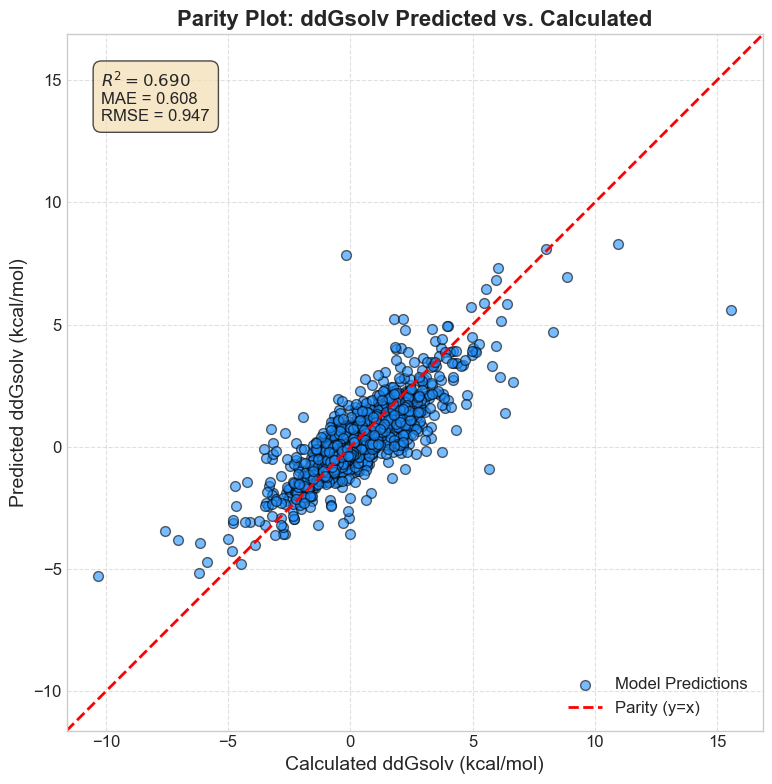

In [11]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import numpy as np

# --- 1. DEFINE YOUR FILE PATHS ---
# Paths you provided for the ground truth (test) and prediction data.
r_test_path = 'data_splits/C1-R-F/test.csv'
r_preds_path = 'Data/Pred/F-R-Predicted_Data.csv'

print(f"Loading calculated values from: {r_test_path}")
print(f"Loading predicted values from: {r_preds_path}")

# --- 2. LOAD DATA USING PANDAS ---
try:
    # Load the ground truth (calculated) data from the test set
    df_test = pd.read_csv(r_test_path)
    # Load the model's predictions
    df_preds = pd.read_csv(r_preds_path)
except FileNotFoundError as e:
    print(f"\nERROR: {e}")
    print("\nPlease make sure you are running this script from the correct parent directory,")
    print("so it can find both the 'data_splits' and 'Data' folders.")
    exit()

# --- 3. EXTRACT THE 'ddGsolv' COLUMNS ---
# It's crucial that these two series have the same number of rows and are correctly ordered.
try:
    # 'ddGsolv' from the test file are the "calculated" or true values
    ddGsolv_calc = df_test['ddGsolv']
    
    # 'ddGsolv' from the predictions file are the "predicted" values
    ddGsolv_pred = df_preds['ddGsolv']
except KeyError as e:
    print(f"\nERROR: Column 'ddGsolv' not found. {e}")
    print("Please ensure the column name is spelled correctly in both CSV files.")
    exit()


# Sanity check for data length
if len(ddGsolv_calc) != len(ddGsolv_pred):
    print(f"\nERROR: The number of data points do not match!")
    print(f"  Test data has {len(ddGsolv_calc)} rows.")
    print(f"  Prediction data has {len(ddGsolv_pred)} rows.")
    print("Please ensure the prediction file corresponds to the correct test set.")
    exit()
else:
    print(f"Successfully loaded {len(ddGsolv_calc)} data points for comparison.")

# --- 4. CALCULATE PERFORMANCE METRICS ---
r2 = r2_score(ddGsolv_calc, ddGsolv_pred)
mae = mean_absolute_error(ddGsolv_calc, ddGsolv_pred)
rmse = np.sqrt(mean_squared_error(ddGsolv_calc, ddGsolv_pred))

print("\n--- Performance Metrics ---")
print(f"R-squared (R²): {r2:.4f}")
print(f"Mean Absolute Error (MAE): {mae:.4f}")
print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")
print("---------------------------\n")


# --- 5. CREATE THE PARITY PLOT ---
print("Generating parity plot...")
fig, ax = plt.subplots(figsize=(8, 8))

# Scatter plot of predicted vs calculated values
ax.scatter(ddGsolv_calc, ddGsolv_pred, alpha=0.6, c='dodgerblue', edgecolors='k', s=50, label='Model Predictions')

# Determine the limits for the parity line to span the entire plot
all_values = pd.concat([ddGsolv_calc, ddGsolv_pred])
# Add a small buffer to the plot limits
buffer = (all_values.max() - all_values.min()) * 0.05 
min_val = all_values.min() - buffer
max_val = all_values.max() + buffer
ax.plot([min_val, max_val], [min_val, max_val], 'r--', lw=2, label='Parity (y=x)')

# Add labels and title
ax.set_xlabel('Calculated ddGsolv (kcal/mol)', fontsize=14)
ax.set_ylabel('Predicted ddGsolv (kcal/mol)', fontsize=14)
ax.set_title('Parity Plot: ddGsolv Predicted vs. Calculated', fontsize=16, fontweight='bold')

# Set the axis limits and aspect ratio for a clean, square plot
ax.set_xlim(min_val, max_val)
ax.set_ylim(min_val, max_val)
ax.set_aspect('equal', adjustable='box')

# Add grid for better readability
ax.grid(True, linestyle='--', alpha=0.6)

# Add performance metrics text box to the plot
stats_text = (
    f'$R^2 = {r2:.3f}$\n'
    f'MAE = {mae:.3f}\n'
    f'RMSE = {rmse:.3f}'
)
# Place text in the upper-left corner
ax.text(0.05, 0.95, stats_text, transform=ax.transAxes, fontsize=12,
        verticalalignment='top', bbox=dict(boxstyle='round,pad=0.5', fc='wheat', alpha=0.7))

# Add legend
ax.legend(loc='lower right', fontsize=12)

# Improve tick label size
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

# Show the plot
plt.tight_layout()

# (Optional) Save the figure to a file
# output_filename = 'F-R-ddGsolv_parity_plot.png'
# fig.savefig(output_filename, dpi=300)
# print(f"Plot saved as '{output_filename}'")

plt.show()

# Task 2.3.2

Put in reaction types

Loading data...

--- Model Performance ---
R-squared (R²): 0.6901
RMSE: 0.9472
MAE:  0.6080
-------------------------

Generating color-coded parity plot...
Plot saved successfully to 'parity_plot_color_coded.png'


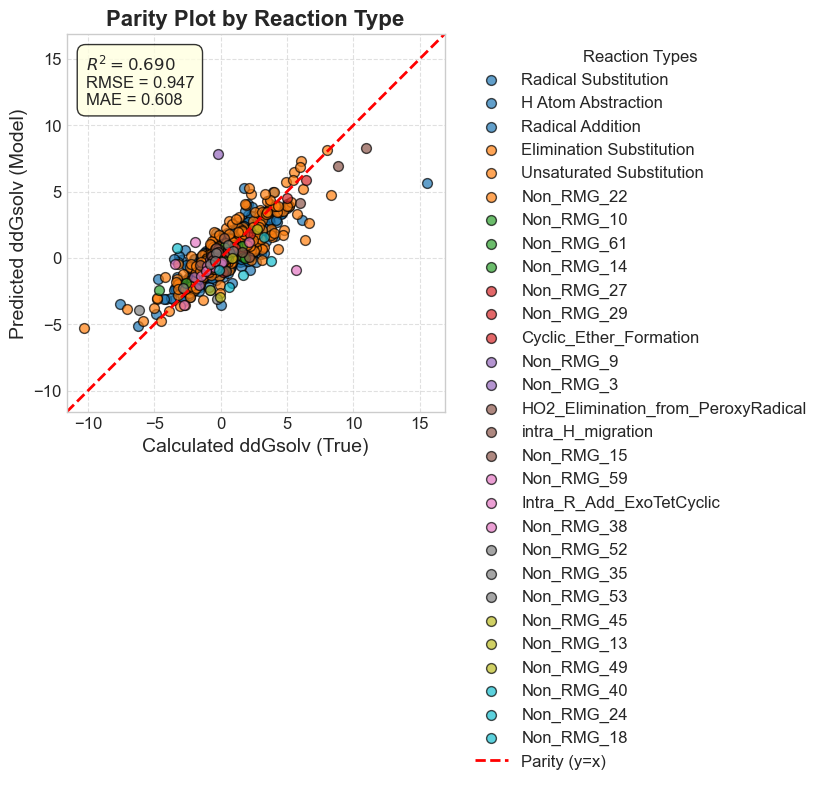

In [10]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
import os

def create_color_coded_parity_plot():
    """
    Loads calculated data, predicted data, and reaction type names,
    merges them, and generates a color-coded parity plot.
    """
    # --- 1. Configuration ---
    # Paths to your input files
    calculated_file = os.path.join('data_splits', 'C1-R-F', 'test.csv')
    predicted_file = os.path.join('Data', 'Pred', 'F-R-Predicted_Data.csv')
    reaction_types_file = os.path.join('Data', 'Radical', 'Sampled','reaction_types.csv')

    # Column names
    true_value_col = 'ddGsolv'
    predicted_value_col = 'ddGsolv'
    reaction_type_id_col = 'rxn_idx'  # Integer ID in the calculated_file
    reaction_type_name_col = 'reaction_type' # String name in reaction_types_file

    # Output file for the plot
    output_plot_file = 'parity_plot_color_coded.png'

    # --- 2. Load and Prepare Data ---
    try:
        print("Loading data...")
        # Load the file with the TRUE values and reaction type IDs
        df_calc = pd.read_csv(calculated_file)
        # Load the file with the PREDICTED values
        df_pred = pd.read_csv(predicted_file)
        # Load the file that maps reaction type IDs to names
        df_types = pd.read_csv(reaction_types_file)

        # --- Data Validation ---
        if reaction_type_id_col not in df_calc.columns:
            print(f"Error: The crucial column '{reaction_type_id_col}' was not found in '{calculated_file}'.")
            print("Please regenerate this file, ensuring the reaction type ID is included.")
            return
        if len(df_calc) != len(df_pred):
            print(f"Error: The calculated and predicted files have different numbers of rows ({len(df_calc)} vs {len(df_pred)}).")
            return

    except FileNotFoundError as e:
        print(f"An error occurred loading files: {e}")
        return

    # --- 3. Merge and Align DataFrames ---
    # Merge the reaction type names into the main calculated dataframe
    df_merged = pd.merge(df_calc, df_types, on=reaction_type_id_col, how='left')

    # Add the predicted values as a new column. This assumes the rows are in the same order.
    df_merged['predicted_ddGsolv'] = df_pred[predicted_value_col]

    # --- 4. Extract Data and Calculate Metrics ---
    y_true = df_merged[true_value_col]
    y_pred = df_merged['predicted_ddGsolv']
    reaction_types = df_merged[reaction_type_name_col]

    r2 = r2_score(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)

    print("\n--- Model Performance ---")
    print(f"R-squared (R²): {r2:.4f}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE:  {mae:.4f}")
    print("-------------------------\n")


    # --- 5. Create the Color-Coded Parity Plot ---
    print("Generating color-coded parity plot...")
    fig, ax = plt.subplots(figsize=(10, 10))

    # Get a list of unique reaction types to create a color map
    unique_types = reaction_types.unique()
    # Using a colormap that is good for categorical data
    colors = plt.get_cmap('tab10')(np.linspace(0, 1, len(unique_types)))
    color_map = dict(zip(unique_types, colors))

    # Plot each reaction type group with a different color
    for r_type, color in color_map.items():
        subset = df_merged[df_merged[reaction_type_name_col] == r_type]
        ax.scatter(
            subset[true_value_col],
            subset['predicted_ddGsolv'],
            color=color,
            label=r_type,
            alpha=0.7,
            edgecolor='k',
            s=50
        )

    # Determine plot limits to make a square plot
    min_val = min(y_true.min(), y_pred.min())
    max_val = max(y_true.max(), y_pred.max())
    buffer = (max_val - min_val) * 0.05

    # Plot the y=x "line of parity"
    ax.plot([min_val - buffer, max_val + buffer], [min_val - buffer, max_val + buffer],
            'r--', linewidth=2, label='Parity (y=x)')

    # Add metrics text to the plot
    metrics_text = (f'$R^2 = {r2:.3f}$\n'
                    f'RMSE = {rmse:.3f}\n'
                    f'MAE = {mae:.3f}')
    ax.text(0.05, 0.95, metrics_text, transform=ax.transAxes, fontsize=12,
            verticalalignment='top', bbox=dict(boxstyle='round,pad=0.5', fc='lightyellow', alpha=0.8))

    # Add labels, title, and grid
    ax.set_xlabel('Calculated ddGsolv (True)', fontsize=14)
    ax.set_ylabel('Predicted ddGsolv (Model)', fontsize=14)
    ax.set_title('Parity Plot by Reaction Type', fontsize=16, fontweight='bold')
    ax.grid(True, linestyle='--', alpha=0.6)

    # Set the axes to be equal
    ax.set_xlim(min_val - buffer, max_val + buffer)
    ax.set_ylim(min_val - buffer, max_val + buffer)
    ax.set_aspect('equal', adjustable='box')

    # Add legend
    ax.legend(title='Reaction Types', bbox_to_anchor=(1.04, 1), loc='upper left')

    # Ensure everything fits, including the legend outside the plot
    plt.tight_layout(rect=[0, 0, 0.85, 1]) # Adjust layout to make space for legend

    # --- 6. Save and show the plot ---
    plt.savefig(output_plot_file, dpi=300, bbox_inches='tight')
    print(f"Plot saved successfully to '{output_plot_file}'")
    plt.show()


if __name__ == '__main__':
    create_color_coded_parity_plot()


Loading data...
Grouped all 'Non_RMG_...' types into a single 'Non_RMG' category.

--- Model Performance ---
R-squared (R²): 0.6901
RMSE: 0.9472
MAE:  0.6080
-------------------------

Generating color-coded parity plot...
Plot saved successfully to 'parity_plot_grouped_color_coded.png'


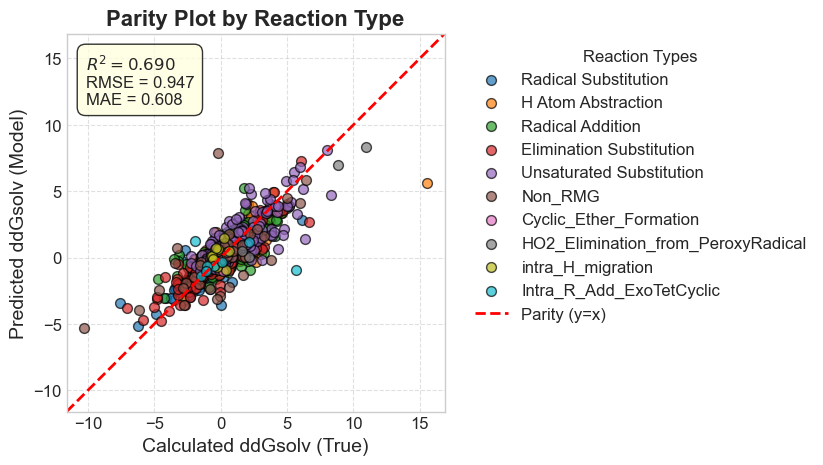

In [9]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
import os

def create_grouped_color_coded_parity_plot():
    """
    Loads data, groups all 'Non_RMG' reaction types into a single category,
    and generates a color-coded parity plot.
    """
    # --- 1. Configuration ---
    # Paths to your input files
    calculated_file = os.path.join('data_splits', 'C1-R-F', 'test.csv')
    predicted_file = os.path.join('Data', 'Pred', 'F-R-Predicted_Data.csv')
    reaction_types_file = os.path.join('Data', 'Radical', 'Sampled','reaction_types.csv')
    # Column names
    true_value_col = 'ddGsolv'
    predicted_value_col = 'ddGsolv'
    reaction_type_id_col = 'rxn_idx'
    reaction_type_name_col = 'reaction_type'

    # Output file for the plot
    output_plot_file = 'parity_plot_grouped_color_coded.png'

    # --- 2. Load and Prepare Data ---
    try:
        print("Loading data...")
        df_calc = pd.read_csv(calculated_file)
        df_pred = pd.read_csv(predicted_file)
        df_types = pd.read_csv(reaction_types_file)
        if reaction_type_id_col not in df_calc.columns:
            print(f"Error: Column '{reaction_type_id_col}' not found in '{calculated_file}'.")
            return
        if len(df_calc) != len(df_pred):
            print(f"Error: Calculated and predicted files have different row counts.")
            return
    except FileNotFoundError as e:
        print(f"An error occurred loading files: {e}")
        return

    # --- 3. Merge, Group, and Align DataFrames ---
    # Merge the reaction type names into the main calculated dataframe
    df_merged = pd.merge(df_calc, df_types, on=reaction_type_id_col, how='left')

    # --- THIS IS THE NEW STEP ---
    # Group all 'Non_RMG' types together.
    # This function checks if a name starts with 'Non_RMG_' and replaces it.
    df_merged[reaction_type_name_col] = df_merged[reaction_type_name_col].apply(
        lambda x: 'Non_RMG' if isinstance(x, str) and x.startswith('Non_RMG_') else x
    )
    print("Grouped all 'Non_RMG_...' types into a single 'Non_RMG' category.")
    # ---------------------------

    # Add the predicted values as a new column
    df_merged['predicted_ddGsolv'] = df_pred[predicted_value_col]

    # --- 4. Extract Data and Calculate Metrics ---
    y_true = df_merged[true_value_col]
    y_pred = df_merged['predicted_ddGsolv']
    reaction_types = df_merged[reaction_type_name_col]

    r2 = r2_score(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)

    print("\n--- Model Performance ---")
    print(f"R-squared (R²): {r2:.4f}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE:  {mae:.4f}")
    print("-------------------------\n")

    # --- 5. Create the Color-Coded Parity Plot ---
    print("Generating color-coded parity plot...")
    fig, ax = plt.subplots(figsize=(10, 10))

    unique_types = reaction_types.dropna().unique()
    colors = plt.get_cmap('tab10')(np.linspace(0, 1, len(unique_types)))
    color_map = dict(zip(unique_types, colors))

    for r_type, color in color_map.items():
        subset = df_merged[df_merged[reaction_type_name_col] == r_type]
        ax.scatter(subset[true_value_col], subset['predicted_ddGsolv'], color=color,
                   label=r_type, alpha=0.7, edgecolor='k', s=50)

    min_val, max_val = min(y_true.min(), y_pred.min()), max(y_true.max(), y_pred.max())
    buffer = (max_val - min_val) * 0.05
    ax.plot([min_val - buffer, max_val + buffer], [min_val - buffer, max_val + buffer],
            'r--', linewidth=2, label='Parity (y=x)')

    metrics_text = (f'$R^2 = {r2:.3f}$\n'
                    f'RMSE = {rmse:.3f}\n'
                    f'MAE = {mae:.3f}')
    ax.text(0.05, 0.95, metrics_text, transform=ax.transAxes, fontsize=12,
            verticalalignment='top', bbox=dict(boxstyle='round,pad=0.5', fc='lightyellow', alpha=0.8))

    ax.set_xlabel('Calculated ddGsolv (True)', fontsize=14)
    ax.set_ylabel('Predicted ddGsolv (Model)', fontsize=14)
    ax.set_title('Parity Plot by Reaction Type', fontsize=16, fontweight='bold')
    ax.grid(True, linestyle='--', alpha=0.6)
    ax.set_xlim(min_val - buffer, max_val + buffer)
    ax.set_ylim(min_val - buffer, max_val + buffer)
    ax.set_aspect('equal', adjustable='box')
    ax.legend(title='Reaction Types', bbox_to_anchor=(1.04, 1), loc='upper left')

    plt.tight_layout(rect=[0, 0, 0.85, 1])

    # --- 6. Save and show the plot ---
    plt.savefig(output_plot_file, dpi=300, bbox_inches='tight')
    print(f"Plot saved successfully to '{output_plot_file}'")
    plt.show()

if __name__ == '__main__':
    create_grouped_color_coded_parity_plot()


Loading and preparing data...

Found 9 reaction types with 2 or more data points to plot.
Skipping the following types: ['Cyclic_Ether_Formation']

Generating subplots...
  - Plotting for 'Elimination Substitution' (R² = 0.7905)
  - Plotting for 'H Atom Abstraction' (R² = 0.6427)
  - Plotting for 'HO2_Elimination_from_PeroxyRadical' (R² = 0.8209)
  - Plotting for 'Intra_R_Add_ExoTetCyclic' (R² = -0.2297)
  - Plotting for 'Non_RMG' (R² = 0.4704)
  - Plotting for 'Radical Addition' (R² = 0.5805)
  - Plotting for 'Radical Substitution' (R² = 0.7016)
  - Plotting for 'Unsaturated Substitution' (R² = 0.6572)
  - Plotting for 'intra_H_migration' (R² = -2.7591)

Subplot figure saved successfully to 'parity_subplots_filtered.png'


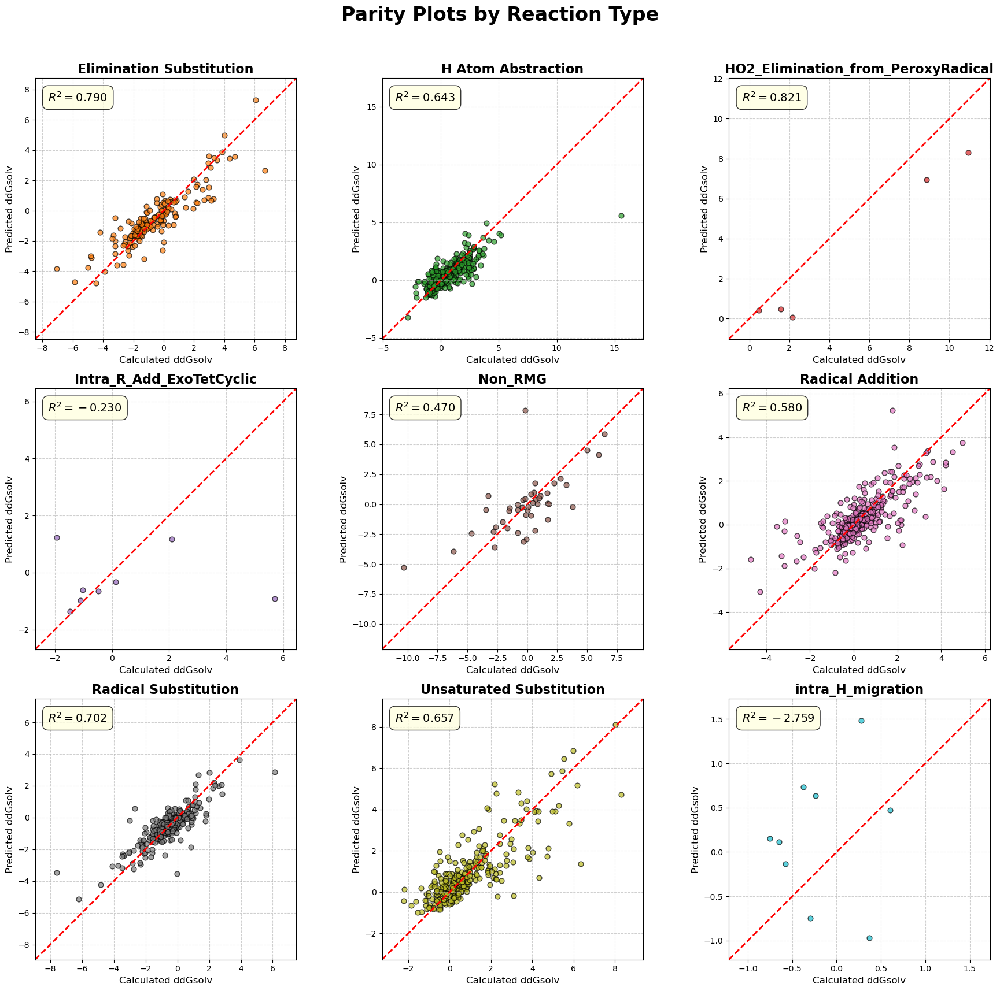

In [30]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import r2_score
import os
import re

def create_filtered_parity_subplots():
    """
    Loads data, groups 'Non_RMG' types, and generates a dynamic grid of
    subplots, completely skipping any reaction type with fewer than 2 data points.
    """
    # --- 1. Configuration ---
    calculated_file = os.path.join('data_splits', 'C1-R-F', 'test.csv')
    predicted_file = os.path.join('Data', 'Pred', 'F-R-Predicted_Data.csv')
    reaction_types_file = os.path.join('Data', 'Radical', 'Sampled','reaction_types.csv')
    true_value_col, predicted_value_col = 'ddGsolv', 'ddGsolv'
    reaction_type_id_col, reaction_type_name_col = 'rxn_idx', 'reaction_type'
    output_plot_file = 'parity_subplots_filtered.png'

    # --- 2. Load and Prepare Data ---
    try:
        print("Loading and preparing data...")
        df_calc = pd.read_csv(calculated_file)
        df_pred = pd.read_csv(predicted_file)
        df_types = pd.read_csv(reaction_types_file)
        if reaction_type_id_col not in df_calc.columns:
            print(f"Error: Column '{reaction_type_id_col}' not found in '{calculated_file}'.")
            return
    except FileNotFoundError as e:
        print(f"An error occurred loading files: {e}")
        return

    # --- 3. Merge and Group DataFrames ---
    df_merged = pd.merge(df_calc, df_types, on=reaction_type_id_col, how='left')
    df_merged[reaction_type_name_col] = df_merged[reaction_type_name_col].apply(
        lambda x: 'Non_RMG' if isinstance(x, str) and x.startswith('Non_RMG_') else x
    )
    df_merged['predicted_ddGsolv'] = df_pred[predicted_value_col]

    # --- 4. Filter for Plottable Reaction Types (THE FIX IS HERE) ---
    # First, identify which types have enough data points (>= 2)
    type_counts = df_merged[reaction_type_name_col].value_counts()
    plottable_types = sorted(type_counts[type_counts >= 2].index.tolist())
    
    print(f"\nFound {len(plottable_types)} reaction types with 2 or more data points to plot.")
    if len(plottable_types) < len(type_counts):
        skipped_types = type_counts[type_counts < 2].index.tolist()
        print(f"Skipping the following types: {skipped_types}")


    # --- 5. Create Color Map and Dynamic Subplot Grid ---
    colors = plt.get_cmap('tab10')(np.linspace(0, 1, 10))
    color_map = dict(zip(sorted(df_merged[reaction_type_name_col].dropna().unique()), colors))

    num_plots = len(plottable_types)
    if num_plots == 0:
        print("No reaction types have enough data to plot. Exiting.")
        return
        
    cols = int(np.ceil(np.sqrt(num_plots)))
    rows = int(np.ceil(num_plots / cols))
    
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 6, rows * 6), squeeze=False)
    axes_flat = axes.flatten()

    print("\nGenerating subplots...")

    # Loop through only the plottable types
    for i, r_type in enumerate(plottable_types):
        ax = axes_flat[i]
        subset = df_merged[df_merged[reaction_type_name_col] == r_type]
        
        y_true = subset[true_value_col]
        y_pred = subset['predicted_ddGsolv']
        r2 = r2_score(y_true, y_pred)
        print(f"  - Plotting for '{r_type}' (R² = {r2:.4f})")
        
        # Plotting the data
        ax.scatter(y_true, y_pred, color=color_map.get(r_type, 'gray'),
                   alpha=0.7, edgecolor='k', s=40)

        # Plotting the parity line
        min_val, max_val = min(y_true.min(), y_pred.min()), max(y_true.max(), y_pred.max())
        buffer = (max_val - min_val) * 0.1 if (max_val - min_val) > 0 else 1
        ax.plot([min_val - buffer, max_val + buffer], [min_val - buffer, max_val + buffer], 'r--', linewidth=2)

        # Customizing each subplot
        ax.set_title(r_type, fontsize=16, fontweight='bold')
        ax.set_xlabel('Calculated ddGsolv', fontsize=12)
        ax.set_ylabel('Predicted ddGsolv', fontsize=12)
        ax.grid(True, linestyle='--', alpha=0.6)
        ax.set_aspect('equal', adjustable='box')
        ax.set_xlim(min_val - buffer, max_val + buffer)
        ax.set_ylim(min_val - buffer, max_val + buffer)

        # Adding the R^2 value
        metrics_text = f'$R^2 = {r2:.3f}$'
        ax.text(0.05, 0.95, metrics_text, transform=ax.transAxes, fontsize=14,
                verticalalignment='top', bbox=dict(boxstyle='round,pad=0.5', fc='lightyellow', alpha=0.8))

    # Hide any unused axes in the grid
    for j in range(num_plots, len(axes_flat)):
        axes_flat[j].set_visible(False)

    # --- 6. Final Figure Customization and Saving ---
    fig.suptitle('Parity Plots by Reaction Type', fontsize=24, fontweight='bold')
    plt.tight_layout(rect=[0, 0.03, 1, 0.96])

    plt.savefig(output_plot_file, dpi=300)
    print(f"\nSubplot figure saved successfully to '{output_plot_file}'")
    plt.show()

if __name__ == '__main__':
    create_filtered_parity_subplots()


Global RMSE: 0.9472

RMSE per type:
reaction_type
Intra_R_Add_ExoTetCyclic              2.624520
Non_RMG                               2.112865
HO2_Elimination_from_PeroxyRadical    1.797607
Cyclic_Ether_Formation                1.181977
Unsaturated Substitution              0.961849
Elimination Substitution              0.954856
intra_H_migration                     0.885313
H Atom Abstraction                    0.878874
Radical Addition                      0.864874
Radical Substitution                  0.702365

Generating bar chart...


/var/folders/cq/1bg1w9pn0p1297c1jbks5zbw0000gn/T/ipykernel_29958/4109048300.py:43: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  rmse_per_type = df_merged.groupby(reaction_type_name_col).apply(



Bar chart saved successfully to 'rmse_by_reaction_type.png'


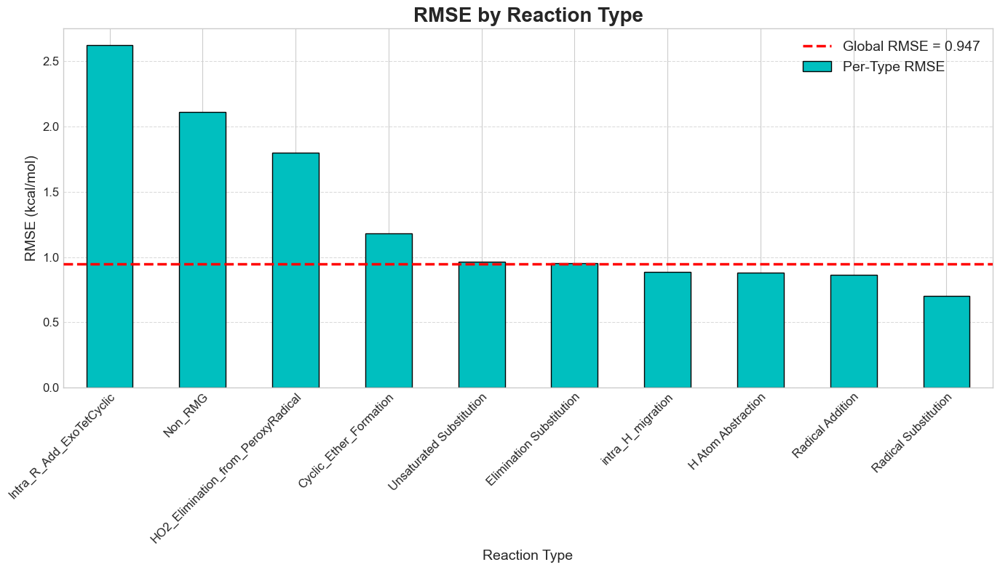

In [15]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import mean_squared_error
import os


data_dir = os.path.join('Data', 'Sample', 'Split')
calculated_file = os.path.join('data_splits', 'C1-R-F', 'test.csv')
predicted_file = os.path.join('Data', 'Pred', 'F-R-Predicted_Data.csv')
reaction_types_file = os.path.join('Data', 'Radical', 'Sampled','reaction_types.csv')

# Define column names
true_value_col = 'ddGsolv'
reaction_type_id_col = 'rxn_idx'
reaction_type_name_col = 'reaction_type'
output_plot_file = 'rmse_by_reaction_type.png'

# Load and Prepare Data
df_calc = pd.read_csv(calculated_file)
df_pred = pd.read_csv(predicted_file)
df_types = pd.read_csv(reaction_types_file)


# Merge and Group DataFrames 
# Merge the calculated data with reaction types
df_merged = pd.merge(df_calc, df_types, on=reaction_type_id_col, how='left')

# Consolidate 'Non_RMG' reaction types into a single category
df_merged[reaction_type_name_col] = df_merged[reaction_type_name_col].apply(
    lambda x: 'Non_RMG' if isinstance(x, str) and x.startswith('Non_RMG_') else x
)

df_merged['predicted_ddGsolv'] = df_pred[true_value_col]

# Calculate Global RMSE across all data points
y_true_global = df_merged[true_value_col]
y_pred_global = df_merged['predicted_ddGsolv']
global_rmse = np.sqrt(mean_squared_error(y_true_global, y_pred_global))
print(f"Global RMSE: {global_rmse:.4f}")

# Calculate RMSE for each reaction type
rmse_per_type = df_merged.groupby(reaction_type_name_col).apply(
    lambda group: np.sqrt(mean_squared_error(group[true_value_col], group['predicted_ddGsolv']))
)
# Sort values for a more readable chart (highest error first)
rmse_per_type = rmse_per_type.sort_values(ascending=False)

print("\nRMSE per type:")
print(rmse_per_type.to_string())

# Create the Bar Chart
print("\nGenerating bar chart...")
plt.style.use('seaborn-v0_8-whitegrid')
fig, ax = plt.subplots(figsize=(14, 8))

# Plot the bars for per-type RMSE
rmse_per_type.plot(kind='bar', ax=ax, color='c', edgecolor='k', zorder=2,
                    label='Per-Type RMSE')

# Plot the horizontal line for Global RMSE
ax.axhline(
    global_rmse,
    color='r',
    linestyle='--',
    linewidth=2.5,
    label=f'Global RMSE = {global_rmse:.3f}',
    zorder=3
)

# Customize and Save Plot 
ax.set_title('RMSE by Reaction Type', fontsize=20, fontweight='bold')
ax.set_xlabel('Reaction Type', fontsize=14)
# Assuming the units are kcal/mol, adjust if necessary
ax.set_ylabel('RMSE (kcal/mol)', fontsize=14)
ax.legend(fontsize=14)
ax.grid(axis='y', linestyle='--', alpha=0.7)
plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")

# Set font size for y-axis labels
ax.tick_params(axis='y', labelsize=12)

fig.tight_layout() # Adjust layout to prevent labels from being cut off
plt.savefig(output_plot_file, dpi=300)
print(f"\nBar chart saved successfully to '{output_plot_file}'")
plt.show()

## Task 3

Using Spiekermann Model to Predict for comparison

In [19]:
import pandas as pd
import os
from sklearn.model_selection import train_test_split

# --- Load your dataset ---
# This part remains identical to ensure the same starting point.
curr_dir = os.getcwd()
path = os.path.join(curr_dir, 'Data', 'Radical', 'all_rxn_all_solvent_bidirection_resonance.csv')
df = pd.read_csv(path)

n_samples = 16000 # Number of Samples Taken from the Larger Dataset of 1.82 Million

df_sampled_all_cols, _ = train_test_split(
    df,
    train_size=n_samples,
    stratify=df['rxn_idx'], # Stratify based on the reaction type column
    random_state=43         # CRITICAL: This ensures we get the same rows as before
)

df_sampled_all_cols.reset_index(drop=True, inplace=True)
output_filename = 'Data/Radical/Sampled/Stratified_Sample_All_Columns.csv'

output_dir = os.path.dirname(output_filename)
df_sampled_all_cols.to_csv(output_filename, index=False)

# Final Output 
display(df_sampled_all_cols.head())

,rxn_smi,solvent_smi,rxn_idx,resonance_idx,direction,solvent_name,Kmeans_split_cluster_idx,DeltaG_ET_gas_molar_kcal_mol,DeltaG_EP_gas_molar_kcal_mol,DeltaDeltaG_ET_solv_molar_kcal_mol,DeltaDeltaG_EP_solv_molar_kcal_mol,DeltaG_ET_soln_molar_kcal_mol,DeltaG_EP_soln_molar_kcal_mol
0,[C:14]([O:15][C:16](=[O:17])[C:18](=[C:19]([H:...,C1CCNCC1,1011,0,forward,piperidine,9,25.294468,8.952006,-0.354084,0.457121,24.940383,9.409127
1,[C:1]([C:2]([C:3]([C:4]([H:14])([H:15])[H:16])...,O=Cc1ccccc1,3613,0,reverse,benzaldehyde,4,30.072324,-9.123422,-0.174915,0.224843,29.897409,-8.898579
2,[C:1]([C:2]([C:3]([H:8])([H:9])[C:15]([C:14]([...,ClCCl,3386,3,reverse,dichloromethane,9,23.797847,7.237647,-0.642687,-1.018532,23.155160,6.219115
3,[C:15](=[C:16]([c:17]1[c:18]([H:26])[c:19]([H:...,Cc1ccccc1,1686,15,forward,toluene,11,17.162415,-3.201385,-0.047216,0.225689,17.115199,-2.975696
4,[C:17]([C:18]([H:26])([H:27])[H:28])([C:19]([H...,CO,1746,3,reverse,methanol,5,58.090552,-1.304846,-0.575833,-0.459959,57.514719,-1.764804


In [20]:
import pandas as pd
import numpy as np
import os

SOURCE_DATA_PATH = 'Data/Radical/Sampled/Stratified_Sample_All_Columns.csv'
SPLIT_DIR = 'data_splits/SP'
REACTION_SMILES_COLUMN = 'rxn_smi'


os.makedirs(SPLIT_DIR, exist_ok=True)
df_full = pd.read_csv(SOURCE_DATA_PATH)
all_unique_reactions = df_full[REACTION_SMILES_COLUMN].unique()

# Set a seed and shuffle the reactions for a random split
np.random.seed(42)
np.random.shuffle(all_unique_reactions)

# Split Reactions into Train/Validation/Test Sets 
n_reactions = len(all_unique_reactions)
train_end_idx = int(0.72 * n_reactions)
val_end_idx = int((0.72 + 0.18) * n_reactions) # Cumulative point is 90%

# Create sets of reaction SMILES for each split
train_rxns = set(all_unique_reactions[:train_end_idx])
val_rxns = set(all_unique_reactions[train_end_idx:val_end_idx])
test_rxns = set(all_unique_reactions[val_end_idx:])

print("\nSplitting reactions into sets:")
print(f"  Train reactions:      {len(train_rxns)}")
print(f"  Validation reactions: {len(val_rxns)}")
print(f"  Test reactions:       {len(test_rxns)}")


# Create and Save the Final DataFrames
print("\nCreating final dataframes based on reaction splits...")
df_train = df_full[df_full[REACTION_SMILES_COLUMN].isin(train_rxns)]
df_val = df_full[df_full[REACTION_SMILES_COLUMN].isin(val_rxns)]
df_test = df_full[df_full[REACTION_SMILES_COLUMN].isin(test_rxns)]

# Define paths for saving
train_path = os.path.join(SPLIT_DIR, 'train.csv')
val_path = os.path.join(SPLIT_DIR, 'val.csv')
test_path = os.path.join(SPLIT_DIR, 'test.csv')

# Save the files
df_train.to_csv(train_path, index=False)
df_val.to_csv(val_path, index=False)
df_test.to_csv(test_path, index=False)


# --- Final Report ---
print("\nData successfully split and saved:")
print(f"  Train set:      {len(df_train):>5} rows -> {train_path}")
print(f"  Validation set: {len(df_val):>5} rows -> {val_path}")
print(f"  Test set:       {len(df_test):>5} rows -> {test_path}")
print(f"  -------------------------------------")
total_points = len(df_train) + len(df_val) + len(df_test)
print(f"  Total points in splits: {total_points} (Should equal original file size: {len(df_full)})")
print(f"  Reaction split (72/18/10): {len(train_rxns)} train / {len(val_rxns)} val / {len(test_rxns)} test")


Splitting reactions into sets:
  Train reactions:      10344
  Validation reactions: 2586
  Test reactions:       1437

Creating final dataframes based on reaction splits...

Data successfully split and saved:
  Train set:      11513 rows -> data_splits/SP/train.csv
  Validation set:  2874 rows -> data_splits/SP/val.csv
  Test set:        1613 rows -> data_splits/SP/test.csv
  -------------------------------------
  Total points in splits: 16000 (Should equal original file size: 16000)
  Reaction split (72/18/10): 10344 train / 2586 val / 1437 test


In [ ]:
import chemprop

r_test_path = 'data_splits/SP/test.csv'
r_preds_path = 'Data/Pred/Sp_D1_Predicted_Data.csv'
model_dir_S1 = 'Models/Spiek-Models/D-MPNN-2/kmeans_split/solv' # Spiekermann D-MPNN 2 - K Means


arguments = [
    '--test_path', r_test_path,
    '--preds_path', r_preds_path,
    '--checkpoint_dir', model_dir_S1,
    '--number_of_molecules','2',
    '--smiles_columns', 'rxn_smi','solvent_smi',
    '--batch_size', '32',
    # '--drop_extra_columns',
    '--no_features_scaling',
    '--ensemble_variance',
    # 'solvent_smiles',
    '--num_workers','0',
    '--individual_ensemble_predictions'
]


args = chemprop.args.PredictArgs().parse_args(arguments)
preds = chemprop.train.make_predictions(args=args)

Loading training args


/Users/yahya/Desktop/Actual/Code/chemprop/chemprop/utils.py:489: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  vars(torch.load(path, map_location=lambda storage, loc: storag

Setting molecule featurization parameters to default.
Loading data


1613it [00:00, 240351.44it/s]
100%|██████████| 1613/1613 [00:00<00:00, 495235.51it/s]


Validating SMILES
Test size = 1,613


  0%|          | 0/5 [00:00<?, ?it/s]/Users/yahya/Desktop/Actual/Code/chemprop/chemprop/utils.py:120: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state = torch.load(path, 

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".


/Users/yahya/Desktop/Actual/Code/chemprop/chemprop/utils.py:434: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state = torch.load(path, map_location=lambda storage, loc: sto

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".


 40%|████      | 2/5 [00:02<00:04,  1.45s/it]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".


 60%|██████    | 3/5 [00:04<00:02,  1.41s/it]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".


 80%|████████  | 4/5 [00:05<00:01,  1.40s/it]

Loading pretrained parameter "encoder.encoder.cached_zero_vector".
Loading pretrained parameter "encoder.encoder.W_i.weight".
Loading pretrained parameter "encoder.encoder.W_h.weight".
Loading pretrained parameter "encoder.encoder.W_o.weight".
Loading pretrained parameter "encoder.encoder.W_o.bias".
Loading pretrained parameter "encoder.encoder_solvent.cached_zero_vector".
Loading pretrained parameter "encoder.encoder_solvent.W_i.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_h.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.weight".
Loading pretrained parameter "encoder.encoder_solvent.W_o.bias".
Loading pretrained parameter "readout.1.weight".
Loading pretrained parameter "readout.1.bias".
Loading pretrained parameter "readout.4.weight".
Loading pretrained parameter "readout.4.bias".


100%|██████████| 5/5 [00:07<00:00,  1.42s/it]

Saving predictions to Data/Pred/Sp_D1_Predicted_Data.csv
Elapsed time = 0:00:07



--- Model Performance ---
R-squared (R²): 0.9216
RMSE: 0.4765
MAE:  0.3160
-------------------------

Generating color-coded parity plot...
Plot saved successfully to 'parity_plot_grouped_color_coded.png'


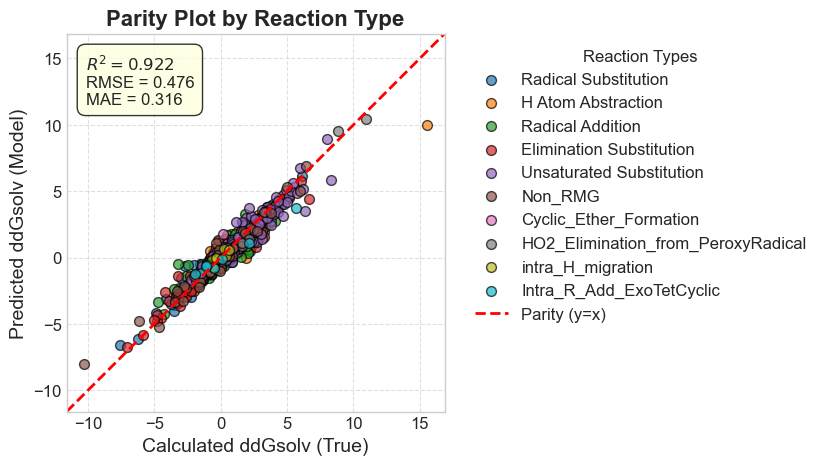

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
import os

calculated_file = os.path.join('data_splits', 'SP', 'test.csv')
predicted_file = os.path.join('Data', 'Pred', 'Sp_D1_Predicted_Data.csv')
reaction_types_file = os.path.join('Data', 'Radical', 'Sampled','reaction_types.csv')
# Column names
true_value_col = 'DeltaDeltaG_ET_solv_molar_kcal_mol'
predicted_value_col = 'DeltaDeltaG_ET_solv_molar_kcal_mol'
reaction_type_id_col = 'rxn_idx'
reaction_type_name_col = 'reaction_type'

# Output file for the plot
output_plot_file = 'parity_plot_grouped_color_coded.png'

# Load and Prepare Data 
df_calc = pd.read_csv(calculated_file)
df_pred = pd.read_csv(predicted_file)
df_types = pd.read_csv(reaction_types_file)

# Merge, Group, and Align DataFrames 
df_merged = pd.merge(df_calc, df_types, on=reaction_type_id_col, how='left')

# Group all 'Non_RMG' types together.
df_merged[reaction_type_name_col] = df_merged[reaction_type_name_col].apply(
    lambda x: 'Non_RMG' if isinstance(x, str) and x.startswith('Non_RMG_') else x
)
df_merged['predicted_DeltaDeltaG_ET_solv_molar_kcal_mol'] = df_pred[predicted_value_col]

# Extract Data and Calculate Metrics
y_true = df_merged[true_value_col]
y_pred = df_merged['predicted_DeltaDeltaG_ET_solv_molar_kcal_mol']
reaction_types = df_merged[reaction_type_name_col]

r2 = r2_score(y_true, y_pred)
rmse = np.sqrt(mean_squared_error(y_true, y_pred))
mae = mean_absolute_error(y_true, y_pred)

print("\n--- Model Performance ---")
print(f"R-squared (R²): {r2:.4f}")
print(f"RMSE: {rmse:.4f}")
print(f"MAE:  {mae:.4f}")
print("-------------------------\n")

# Create the Color-Coded Parity Plot 
print("Generating color-coded parity plot...")
fig, ax = plt.subplots(figsize=(10, 10))
unique_types = reaction_types.dropna().unique()
colors = plt.get_cmap('tab10')(np.linspace(0, 1, len(unique_types)))
color_map = dict(zip(unique_types, colors))
for r_type, color in color_map.items():
    subset = df_merged[df_merged[reaction_type_name_col] == r_type]
    ax.scatter(subset[true_value_col], subset['predicted_DeltaDeltaG_ET_solv_molar_kcal_mol'], color=color,
                label=r_type, alpha=0.7, edgecolor='k', s=50)

min_val, max_val = min(y_true.min(), y_pred.min()), max(y_true.max(), y_pred.max())
buffer = (max_val - min_val) * 0.05
ax.plot([min_val - buffer, max_val + buffer], [min_val - buffer, max_val + buffer],
        'r--', linewidth=2, label='Parity (y=x)')

metrics_text = (f'$R^2 = {r2:.3f}$\n'
                f'RMSE = {rmse:.3f}\n'
                f'MAE = {mae:.3f}')
ax.text(0.05, 0.95, metrics_text, transform=ax.transAxes, fontsize=12,
        verticalalignment='top', bbox=dict(boxstyle='round,pad=0.5', fc='lightyellow', alpha=0.8))

ax.set_xlabel('Calculated ddGsolv (True)', fontsize=14)
ax.set_ylabel('Predicted ddGsolv (Model)', fontsize=14)
ax.set_title('Parity Plot by Reaction Type', fontsize=16, fontweight='bold')
ax.grid(True, linestyle='--', alpha=0.6)
ax.set_xlim(min_val - buffer, max_val + buffer)
ax.set_ylim(min_val - buffer, max_val + buffer)

ax.set_aspect('equal', adjustable='box')
ax.legend(title='Reaction Types', bbox_to_anchor=(1.04, 1), loc='upper left')

plt.tight_layout(rect=[0, 0, 0.85, 1])

# Save and show the plot 
plt.savefig(output_plot_file, dpi=300, bbox_inches='tight')
print(f"Plot saved successfully to '{output_plot_file}'")
plt.show()



Found 9 reaction types with 2 or more data points to plot.
Skipping the following types: ['Cyclic_Ether_Formation']

Generating subplots...
  - Plotting for 'Elimination Substitution' (R² = 0.9478)
  - Plotting for 'H Atom Abstraction' (R² = 0.8930)
  - Plotting for 'HO2_Elimination_from_PeroxyRadical' (R² = 0.9823)
  - Plotting for 'Intra_R_Add_ExoTetCyclic' (R² = 0.8684)
  - Plotting for 'Non_RMG' (R² = 0.9467)
  - Plotting for 'Radical Addition' (R² = 0.8643)
  - Plotting for 'Radical Substitution' (R² = 0.9108)
  - Plotting for 'Unsaturated Substitution' (R² = 0.9116)
  - Plotting for 'intra_H_migration' (R² = 0.6677)

Subplot figure saved successfully to 'parity_subplots_filtered.png'


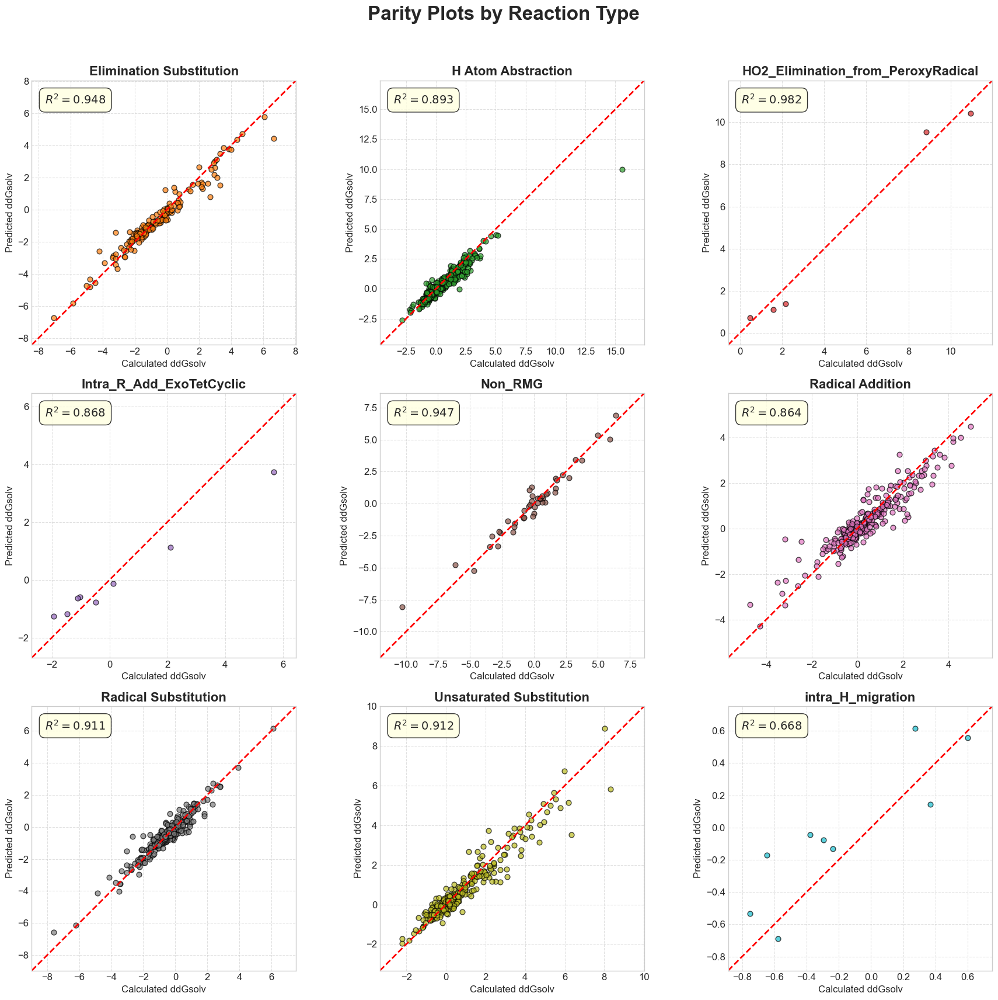

In [27]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import r2_score
import os
import re


calculated_file = os.path.join('data_splits', 'SP', 'test.csv')
predicted_file = os.path.join('Data', 'Pred', 'Sp_D1_Predicted_Data.csv')
reaction_types_file = os.path.join('Data', 'Radical', 'Sampled','reaction_types.csv')
true_value_col, predicted_value_col = 'DeltaDeltaG_ET_solv_molar_kcal_mol', 'DeltaDeltaG_ET_solv_molar_kcal_mol'
reaction_type_id_col, reaction_type_name_col = 'rxn_idx', 'reaction_type'
output_plot_file = 'parity_subplots_filtered.png'

df_calc = pd.read_csv(calculated_file)
df_pred = pd.read_csv(predicted_file)
df_types = pd.read_csv(reaction_types_file)

# Merge and Group DataFrames 
df_merged = pd.merge(df_calc, df_types, on=reaction_type_id_col, how='left')
df_merged[reaction_type_name_col] = df_merged[reaction_type_name_col].apply(
    lambda x: 'Non_RMG' if isinstance(x, str) and x.startswith('Non_RMG_') else x
)
df_merged['predicted_ddGsolv'] = df_pred[predicted_value_col]
type_counts = df_merged[reaction_type_name_col].value_counts()
plottable_types = sorted(type_counts[type_counts >= 2].index.tolist())

print(f"\nFound {len(plottable_types)} reaction types with 2 or more data points to plot.")
if len(plottable_types) < len(type_counts):
    skipped_types = type_counts[type_counts < 2].index.tolist()
    print(f"Skipping the following types: {skipped_types}")


# Create Color Map and Dynamic Subplot Grid
colors = plt.get_cmap('tab10')(np.linspace(0, 1, 10))
color_map = dict(zip(sorted(df_merged[reaction_type_name_col].dropna().unique()), colors))

num_plots = len(plottable_types)
    
cols = int(np.ceil(np.sqrt(num_plots)))
rows = int(np.ceil(num_plots / cols))

fig, axes = plt.subplots(rows, cols, figsize=(cols * 6, rows * 6), squeeze=False)
axes_flat = axes.flatten()

print("\nGenerating subplots...")

# Loop through only the plottable types
for i, r_type in enumerate(plottable_types):
    ax = axes_flat[i]
    subset = df_merged[df_merged[reaction_type_name_col] == r_type]
    
    y_true = subset[true_value_col]
    y_pred = subset['predicted_ddGsolv']
    r2 = r2_score(y_true, y_pred)
    print(f"  - Plotting for '{r_type}' (R² = {r2:.4f})")
    
    # Plotting the data
    ax.scatter(y_true, y_pred, color=color_map.get(r_type, 'gray'),
                alpha=0.7, edgecolor='k', s=40)

    # Plotting the parity line
    min_val, max_val = min(y_true.min(), y_pred.min()), max(y_true.max(), y_pred.max())
    buffer = (max_val - min_val) * 0.1 if (max_val - min_val) > 0 else 1
    ax.plot([min_val - buffer, max_val + buffer], [min_val - buffer, max_val + buffer], 'r--', linewidth=2)

    # Customizing each subplot
    ax.set_title(r_type, fontsize=16, fontweight='bold')
    ax.set_xlabel('Calculated ddGsolv', fontsize=12)
    ax.set_ylabel('Predicted ddGsolv', fontsize=12)
    ax.grid(True, linestyle='--', alpha=0.6)
    ax.set_aspect('equal', adjustable='box')
    ax.set_xlim(min_val - buffer, max_val + buffer)
    ax.set_ylim(min_val - buffer, max_val + buffer)

    # Adding the R^2 value
    metrics_text = f'$R^2 = {r2:.3f}$'
    ax.text(0.05, 0.95, metrics_text, transform=ax.transAxes, fontsize=14,
            verticalalignment='top', bbox=dict(boxstyle='round,pad=0.5', fc='lightyellow', alpha=0.8))

# Hide any unused axes in the grid
for j in range(num_plots, len(axes_flat)):
    axes_flat[j].set_visible(False)

# Final Figure Customization and Saving
fig.suptitle('Parity Plots by Reaction Type', fontsize=24, fontweight='bold')
plt.tight_layout(rect=[0, 0.03, 1, 0.96])

plt.savefig(output_plot_file, dpi=300)
print(f"\nSubplot figure saved successfully to '{output_plot_file}'")
plt.show()